In [1]:
import numpy as np
from netCDF4 import Dataset
from collections import Counter
from matplotlib.pyplot import figure
import matplotlib.pyplot as plt
import warnings
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import matplotlib
import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning)
from minisom import MiniSom, asymptotic_decay
import xarray as xr
from itertools import product
import pandas as pd
from matplotlib.colors import TwoSlopeNorm
import glob


Note: Much of the data provided is heavily preprocessed to accomodate size constraints. Code that is commented out was originally used to create the figures. We provided data to run as much of the original code as possible while staying within the constraints. Code that is not commented out can be used to generate the figures with the preprocessed data that was provided.

## View defined coastline

In [2]:
cesmcalicoast = np.zeros([18,7])
cesmcalicoast[6:9,0] = 1
cesmcalicoast[5,1] = 1
cesmcalicoast[4,1] = 1
cesmcalicoast[2:4,2] = 1
cesmcalicoast[1,3:5] = 1
cesmcalicoast[0,5] = 1

/glade/work/timothyh/miniconda3/envs/analysis/lib/python3.8/site-packages/cartopy/mpl/gridliner.py:307: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/timothyh/miniconda3/envs/analysis/lib/python3.8/site-packages/cartopy/mpl/gridliner.py:343: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '


[]

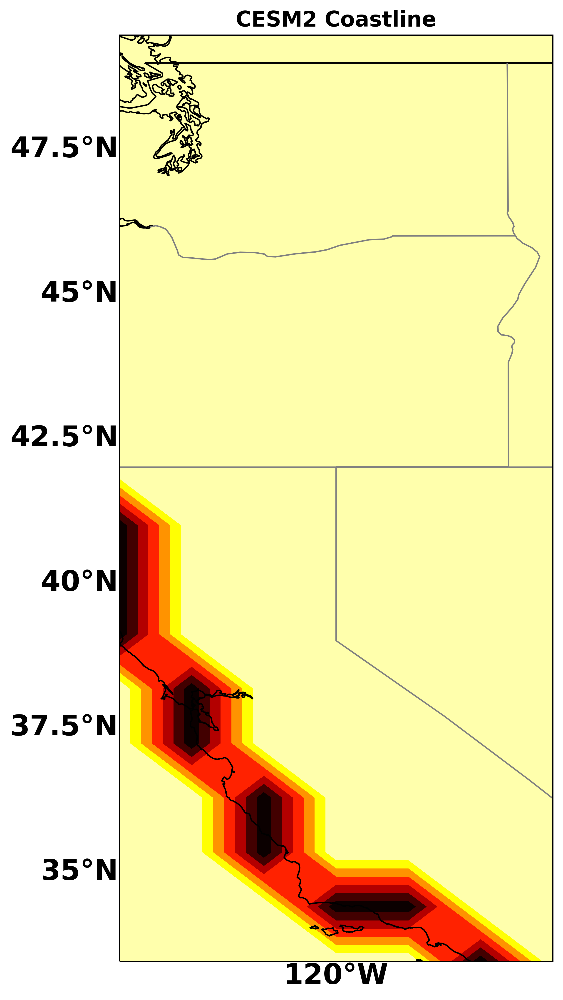

In [3]:
# view coastline
figure(num=None, figsize=(16, 12), dpi=450, facecolor='w', edgecolor='k')
ax = plt.axes(projection = ccrs.PlateCarree(central_longitude= -102.5,globe=None))
colormap = plt.cm.get_cmap('hot') 
lat = Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/nature_cc/cesmhistariwv.nc').variables['lat'][:]
lon = Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/nature_cc/cesmhistariwv.nc').variables['lon'][:]

plt.contourf(lon[:],lat[:],cesmcalicoast[:],
			transform=ccrs.PlateCarree(),extend='max',cmap=colormap.reversed())


ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.BORDERS)
states_provinces = cfeature.NaturalEarthFeature(
		category='cultural',
		name='admin_1_states_provinces_lines',
		scale='50m',
		facecolor='none')
SOURCE = 'Natural Earth'
LICENSE = 'public domain'
ax.add_feature(states_provinces, edgecolor='gray')

gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
				  linewidth=0, color='gray', alpha=0.5)
gl.xlabel_style = {'size': 20, 'weight': 'bold'}
gl.ylabel_style = {'size': 20, 'weight': 'bold'}
gl.xlocator = matplotlib.ticker.FixedLocator([-124,-120,-116,-112])
gl.ylocator = matplotlib.ticker.FixedLocator([32.5,35,37.5,40,42.5,45,47.5])

gl.xlabels_top = False
gl.ylabels_right = False

plt.title('CESM2 Coastline',weight = 'bold',fontsize = 15)
plt.plot()


In [4]:
whomecalicoast = np.zeros([29,9])
whomecalicoast[12:29,0] = 1
whomecalicoast[10:12,1] = 1
whomecalicoast[7:10,2] = 1
whomecalicoast[6,3] = 1
whomecalicoast[3:6,4] = 1
whomecalicoast[3,4:6] = 1
whomecalicoast[2,6:8] = 1
whomecalicoast[0:2,8] = 1

[]

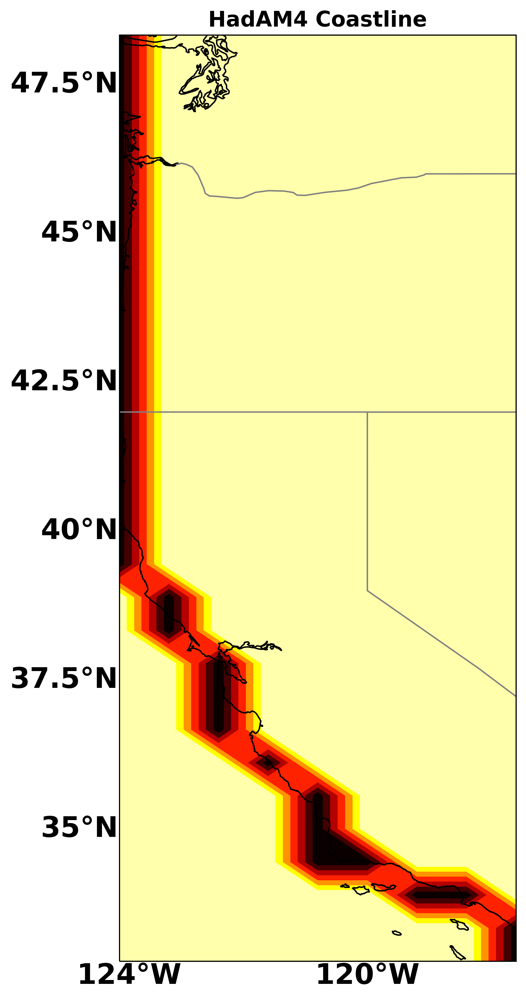

In [5]:
# view coastline
figure(num=None, figsize=(16, 12), dpi=450, facecolor='w', edgecolor='k')
ax = plt.axes(projection = ccrs.PlateCarree(central_longitude= -102.5,globe=None))
colormap = plt.cm.get_cmap('hot') 
lat = Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/nature_cc/histariwv.nc').variables['lat'][:]
lon = Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/nature_cc/histariwv.nc').variables['lon'][:]

plt.contourf(lon[:],lat[:],whomecalicoast[:],
			transform=ccrs.PlateCarree(),extend='max',cmap=colormap.reversed())


ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.BORDERS)
states_provinces = cfeature.NaturalEarthFeature(
		category='cultural',
		name='admin_1_states_provinces_lines',
		scale='50m',
		facecolor='none')
SOURCE = 'Natural Earth'
LICENSE = 'public domain'
ax.add_feature(states_provinces, edgecolor='gray')

gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
				  linewidth=0, color='gray', alpha=0.5)
gl.xlabel_style = {'size': 20, 'weight': 'bold'}
gl.ylabel_style = {'size': 20, 'weight': 'bold'}
gl.xlocator = matplotlib.ticker.FixedLocator([-124,-120,-116,-112])
gl.ylocator = matplotlib.ticker.FixedLocator([32.5,35,37.5,40,42.5,45,47.5])

gl.xlabels_top = False
gl.ylabels_right = False

plt.title('HadAM4 Coastline',weight = 'bold',fontsize = 15)
plt.plot()


In [6]:
# Load ARDT data and compute AR IWV in historical CESM
#cesmcalicoast = np.zeros([27,8])
#cesmcalicoast[8:20,1] = 1
#cesmcalicoast[7,2] = 1
#cesmcalicoast[6,2] = 1
#cesmcalicoast[4:6,3] = 1
#cesmcalicoast[3,4:6] = 1
#cesmcalicoast[2,6] = 1
#cesmpnwcoast = np.zeros([72,61])
#cesmpnwcoast[20:28,44] = 1
#cmaskscesmhist = Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/cesmhistmasks.nc').variables['classmasks'][:,9:36,43:51]*cesmcalicoast
#emaskscesmhist = Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/cesmhistmasks.nc').variables['eventmasks'][:,9:36,43:51]*cesmcalicoast 
#ariwvcesmhist = np.reshape(Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/CESMhist.nc').variables['TMQ'][:,:,9:36,43:51],[2880*40,27,8])*cmaskscesmhist

In [7]:
# Load ARDT data and compute AR IWV in historical CESM
ariwvcesmhist = np.reshape(Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/nature_cc/cesmhistariwv.nc').variables['AR_IWV'][:,:,:9,:],[2880*40,9,7])*cesmcalicoast[:9,:]
emaskscesmhist = np.reshape(Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/nature_cc/cesmhistariwv.nc').variables['event_masks'][:,:,:9,:],[2880*40,9,7])*cesmcalicoast[:9,:]


In [8]:
# Load ARDT data and compute AR IWV in CESM SSP 3-7.0

#cmasksssp370 = Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/cesmssp370masks.nc').variables['classmasks'][:,9:36,43:51]*cesmcalicoast
#emasksssp370 = Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/cesmssp370masks.nc').variables['eventmasks'][:,9:36,43:51]*cesmcalicoast
#ariwvssp370 = np.reshape(Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/CESMssp370.nc').variables['TMQ'][:,:,9:36,43:51],[2880*50,27,8])*cmasksssp370

In [9]:
ariwvcesmssp370 = np.reshape(Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/nature_cc/cesmssp370ariwv.nc').variables['AR_IWV'][:,:,:9,:],[2880*50,9,7])*cesmcalicoast[:9,:]
emaskscesmssp370 = np.reshape(Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/nature_cc/cesmssp370ariwv.nc').variables['event_masks'][:,:,:9,:],[2880*50,9,7])*cesmcalicoast[:9,:]

In [10]:
# Compute severity of all events
uniqueeventsssp370 = np.unique(emaskscesmssp370)
max_iwvssp370 = np.zeros([len(uniqueeventsssp370)-1])
i = 1
while i < len(uniqueeventsssp370):
	max_iwvssp370[i-1] = np.max(ariwvcesmssp370[emaskscesmssp370==uniqueeventsssp370[i]])
	i+=1
i = 0
number_of_years = np.shape(emaskscesmssp370)[0]/360
iwv_upper_limit = int(np.floor(np.max(max_iwvssp370)))
calissp370 = np.zeros([iwv_upper_limit])
while i < iwv_upper_limit:
	calissp370[i] = number_of_years/len(max_iwvssp370[max_iwvssp370>=i])
	i+=1

In [11]:
#repeat for HIST
uniqueeventshist = np.unique(emaskscesmhist)
max_iwvhist = np.zeros([len(uniqueeventshist)-1])
i = 1
while i < len(uniqueeventshist):
	max_iwvhist[i-1] = np.max(ariwvcesmhist[emaskscesmhist==uniqueeventshist[i]])
	i+=1
i = 0
number_of_years = np.shape(emaskscesmhist)[0]/360
iwv_upper_limit = int(np.floor(np.max(max_iwvhist)))
calihist = np.zeros([iwv_upper_limit])
while i < iwv_upper_limit:
	calihist[i] = number_of_years/len(max_iwvhist[max_iwvhist>=i])
	i+=1

In [12]:
# Reshape data and flip axes

#cmaskshist = np.reshape(np.flip(Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/whomehistmasks.nc').variables['classmasks'][:],axis=1)[:,14:31,67:76],[2889,360,17,9])*whomecalicoast
#emaskshist = np.reshape(np.flip(Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/whomehistmasks.nc').variables['eventmasks'][:],axis=1)[:,14:31,67:76],[2889,360,17,9])*whomecalicoast
#ariwv = (np.flip(Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/whomehist.nc').variables['IWV'][:],axis=2)[:,:,14:31,67:76])*cmaskshsit

#cmasks1_5c = np.reshape(np.flip(Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/whome15masks.nc').variables['classmasks'][:],axis=1)[:,14:31,67:76],[2006,360,17,9])*whomecalicoast
#emasks1_5c = np.reshape(np.flip(Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/whome15masks.nc').variables['eventmasks'][:],axis=1)[:,14:31,67:76],[2006,360,17,9])*whomecalicoast
#ariwv1_5c = (np.flip(Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/whome15c.nc').variables['IWV'][:],axis=2)[:,:,14:31,67:76])*cmasks1_5c

#cmasks2c = np.reshape(np.flip(Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/whome2masks.nc').variables['classmasks'][:],axis=1)[:,14:31,67:76],[1882,360,17,9])*whomecalicoast
#emasks2c = np.reshape(np.flip(Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/whome2masks.nc').variables['eventmasks'][:],axis=1)[:,14:31,67:76],[1882,360,17,9])*whomecalicoast
#ariwv2c = (np.flip(Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/whome2c.nc').variables['IWV'][:],axis=2)[:,:,14:31,67:76])*cmasks2c

In [13]:
emaskswhomehist = Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/nature_cc/histariwv.nc').variables['event_masks'][:,:,:17,:]*whomecalicoast[:17,:]
ariwvwhomehist = Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/nature_cc/histariwv.nc').variables['AR_IWV'][:,:,:17,:]*whomecalicoast[:17,:]

emaskswhome1_5c = Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/nature_cc/1_5ariwv.nc').variables['event_masks'][:,:,:17,:]*whomecalicoast[:17,:]
ariwvwhome1_5c = Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/nature_cc/1_5ariwv.nc').variables['AR_IWV'][:,:,:17,:]*whomecalicoast[:17,:]

emaskswhome2c = Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/nature_cc/2ariwv.nc').variables['event_masks'][:,:,:17,:]*whomecalicoast[:17,:]
ariwvwhome2c = Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/nature_cc/2ariwv.nc').variables['AR_IWV'][:,:,:17,:]*whomecalicoast[:17,:]

In [14]:
# Compute severity of all events
uniqueeventswhomehist = np.unique(emaskswhomehist)
max_iwvwhomehist = np.zeros([len(uniqueeventswhomehist)-1])
i = 1
while i < len(uniqueeventswhomehist):
	max_iwvwhomehist[i-1] = np.max(ariwvwhomehist[emaskswhomehist==uniqueeventswhomehist[i]])
	i+=1
i = 0
number_of_years = np.shape(emaskswhomehist)[0]
iwv_upper_limit = int(np.floor(np.max(max_iwvwhomehist)))
caliwhomehist = np.zeros([iwv_upper_limit])
while i < iwv_upper_limit:
	caliwhomehist[i] = number_of_years/len(max_iwvwhomehist[max_iwvwhomehist>=i])
	i+=1

In [15]:
# Compute severity of all events
uniqueeventswhome1_5c = np.unique(emaskswhome1_5c)
max_iwvwhome1_5c = np.zeros([len(uniqueeventswhome1_5c)-1])
i = 1
while i < len(uniqueeventswhome1_5c):
	max_iwvwhome1_5c[i-1] = np.max(ariwvwhome1_5c[emaskswhome1_5c==uniqueeventswhome1_5c[i]])
	i+=1
i = 0
number_of_years = np.shape(emaskswhome1_5c)[0]
iwv_upper_limit = int(np.floor(np.max(max_iwvwhome1_5c)))
caliwhome1_5c = np.zeros([iwv_upper_limit])
while i < iwv_upper_limit:
	caliwhome1_5c[i] = number_of_years/len(max_iwvwhome1_5c[max_iwvwhome1_5c>=i])
	i+=1

In [16]:
# Compute severity of all events
uniqueeventswhome2c = np.unique(emaskswhome2c)
max_iwvwhome2c = np.zeros([len(uniqueeventswhome2c)-1])
i = 1
while i < len(uniqueeventswhome2c):
	max_iwvwhome2c[i-1] = np.max(ariwvwhome2c[emaskswhome2c==uniqueeventswhome2c[i]])
	i+=1
i = 0
number_of_years = np.shape(emaskswhome2c)[0]
iwv_upper_limit = int(np.floor(np.max(max_iwvwhome2c)))
caliwhome2c = np.zeros([iwv_upper_limit])
while i < iwv_upper_limit:
	caliwhome2c[i] = number_of_years/len(max_iwvwhome2c[max_iwvwhome2c>=i])
	i+=1

In [17]:
#Perform Bootstrapping, repeat for each scenario
Num_samples = emaskswhome2c.shape[0]
x = np.arange(emaskswhome2c.shape[0])
number_of_years = np.shape(emaskswhome2c)[0]

Nbs = 1000
P_Bootstrap=np.zeros([1000])
P_Bootstrap1=np.zeros([1000])
P_Bootstrap2=np.zeros([1000])

ii = 0
while ii< Nbs:
    idx = np.random.choice(x,Num_samples)
    max_iwvwhome2c = []
    i = 0
    while i <  len(idx):
        j = 0
        uniqueeventswhome2c = np.unique(emaskswhome2c[idx[i],:,:])
        while j < len(uniqueeventswhome2c):
            max_iwvwhome2c.append(np.max(ariwvwhome2c[idx[i],:,:][emaskswhome2c[idx[i],:,:]==uniqueeventswhome2c[j]]))
            j+=1
        i+=1
    P_Bootstrap[ii] = sorted(max_iwvwhome2c)[(-1)*int(number_of_years)]
    P_Bootstrap1[ii] = sorted(max_iwvwhome2c)[(-1)*int(number_of_years/10)]
    P_Bootstrap2[ii] = sorted(max_iwvwhome2c)[int(np.round((-1)*(number_of_years/100)))]
    ii+=1

In [18]:
#Compute 95% intervals, repeat for all scenarios
print("1 year lower bound = "+str(np.round(np.percentile(P_Bootstrap,2.5),2))+"mm")
print("1 year upper bound = "+str(np.round(np.percentile(P_Bootstrap,97.5),2))+"mm")
print("10 year lower bound = "+str(np.round(np.percentile(P_Bootstrap1,2.5),2))+"mm")
print("10 year upper bound = "+str(np.round(np.percentile(P_Bootstrap1,97.5),2))+"mm")
print("100 year lower bound = "+str(np.round(np.percentile(P_Bootstrap2,2.5),2))+"mm")
print("100 year upper bound = "+str(np.round(np.percentile(P_Bootstrap2,97.5),2))+"mm")


1 year lower bound = 35.63mm
1 year upper bound = 36.26mm
10 year lower bound = 44.55mm
10 year upper bound = 45.67mm
100 year lower bound = 49.35mm
100 year upper bound = 52.19mm


# recalculate for all scenarios and both models

## Figure 1a

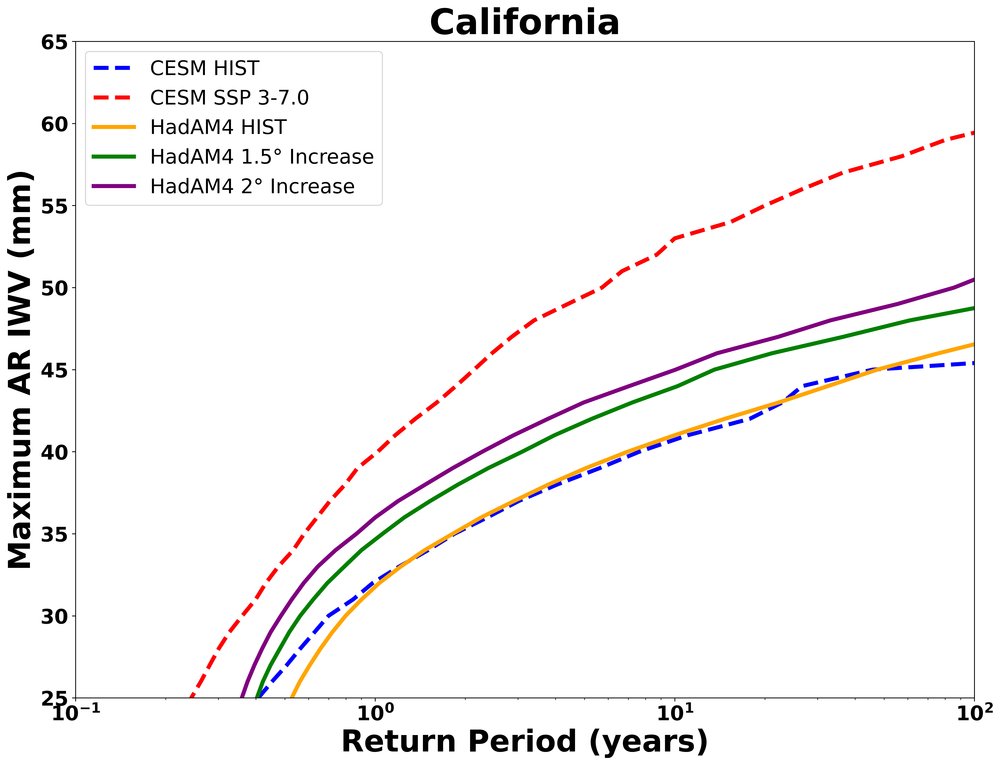

In [19]:
figure(num=None, figsize=(16, 12), dpi=450, facecolor='w', edgecolor='k')
xssp370 = np.arange(len(calissp370))
xwhomehist = np.arange(len(caliwhomehist))
xcesmhist = np.arange(len(calihist))
xwhome15 = np.arange(len(caliwhome1_5c))
xwhome2 = np.arange(len(caliwhome2c))
plt.plot(calihist,xcesmhist,linewidth = 4, label = "CESM HIST",color = "Blue",linestyle="--")
plt.plot(calissp370,xssp370,linewidth = 4, label = "CESM SSP 3-7.0",color = "Red",linestyle="--")

plt.plot(caliwhomehist,xwhomehist,linewidth = 4, label = "HadAM4 HIST", color = "Orange")
plt.plot(caliwhome1_5c,xwhome15,linewidth = 4, label = "HadAM4 1.5° Increase", color = "Green")
plt.plot(caliwhome2c,xwhome2,linewidth = 4, label = "HadAM4 2° Increase", color = "Purple")


plt.xscale("log")
plt.title("California",weight='bold',size = 35)
plt.xlabel("Return Period (years)",weight='bold',size = 30)
plt.ylabel("Maximum AR IWV (mm)",weight='bold',size = 30)
plt.xlim([0.1,100])
plt.ylim([25,65])
plt.yticks(weight='bold',size = 20)
plt.xticks(weight='bold',size = 20)
plt.legend(prop={'size': 20})

In [68]:
number_of_yearshist = np.shape(emaskscesmhist)[0]/360

seasonal_events = np.zeros([int(number_of_yearshist)])
i = 0
while i < int(number_of_yearshist):
	idx = np.where(np.max(ariwvcesmhist[i*360:(i+1)*360,:,:],axis=(1,2))>sorted(max_iwvhist)[(-1)*int(number_of_yearshist)])[0]
	seasonal_events[i] = len(np.unique(emaskscesmhist[i*360:(i+1)*360,:,:][idx,:,:]))
	i+=1
Seasonaliwvcesmcalihist = Counter(seasonal_events)
cesmhistiwv = np.array([Seasonaliwvcesmcalihist[0],Seasonaliwvcesmcalihist[2],Seasonaliwvcesmcalihist[3],Seasonaliwvcesmcalihist[4],Seasonaliwvcesmcalihist[5],Seasonaliwvcesmcalihist[6],Seasonaliwvcesmcalihist[7],Seasonaliwvcesmcalihist[8],Seasonaliwvcesmcalihist[9]])*100/number_of_yearshist

In [69]:
number_of_years = np.shape(emaskscesmssp370)[0]/360

seasonal_events = np.zeros([int(number_of_years)])
i = 0
while i < int(number_of_years):
	idx = np.where(np.max(ariwvcesmssp370[i*360:(i+1)*360,:,:],axis=(1,2))>sorted(max_iwvhist)[(-1)*int(number_of_yearshist)])[0]
	seasonal_events[i] = len(np.unique(emaskscesmssp370[i*360:(i+1)*360,:,:][idx,:,:]))
	i+=1
Seasonaliwvcesmcalissp370 = Counter(seasonal_events)
cesmssp370iwv = np.array([Seasonaliwvcesmcalissp370[0],Seasonaliwvcesmcalissp370[2],Seasonaliwvcesmcalissp370[3],Seasonaliwvcesmcalissp370[4],Seasonaliwvcesmcalissp370[5],Seasonaliwvcesmcalissp370[6],Seasonaliwvcesmcalissp370[7],Seasonaliwvcesmcalissp370[8],Seasonaliwvcesmcalissp370[9]])*100/number_of_years

In [81]:
number_of_yearshist = np.shape(emaskswhomehist)[0]
ariwvwhomehist = np.reshape(ariwvwhomehist,[2889*360,17,9])
emaskswhomehist = np.reshape(emaskswhomehist,[2889*360,17,9])
seasonal_events = np.zeros([int(number_of_yearshist)])
i = 0
while i < int(number_of_yearshist):
	idx = np.where(np.max(ariwvwhomehist[i*360:(i+1)*360,:,:],axis=(1,2))>sorted(max_iwvwhomehist)[(-1)*int(number_of_yearshist)])[0]
	seasonal_events[i] = len(np.unique(emaskswhomehist[i*360:(i+1)*360,:,:][idx,:,:]))
	i+=1
Seasonaliwvwhomecalihist = Counter(seasonal_events)
whomehistiwv = np.array([Seasonaliwvwhomecalihist[0],Seasonaliwvwhomecalihist[2],Seasonaliwvwhomecalihist[3],Seasonaliwvwhomecalihist[4],Seasonaliwvwhomecalihist[5],Seasonaliwvwhomecalihist[6],Seasonaliwvwhomecalihist[7],Seasonaliwvwhomecalihist[8],Seasonaliwvwhomecalihist[9]])*100/number_of_yearshist

In [76]:
number_of_years = np.shape(emaskswhome1_5c)[0]
ariwvwhome1_5c = np.reshape(ariwvwhome1_5c,[2006*360,17,9])
emaskswhome1_5c = np.reshape(emaskswhome1_5c,[2006*360,17,9])
seasonal_events = np.zeros([int(number_of_years)])
i = 0
while i < int(number_of_years):
	idx = np.where(np.max(ariwvwhome1_5c[i*360:(i+1)*360,:],axis=1)>sorted(max_iwvwhomehist)[(-1)*int(number_of_yearshist)])[0]
	seasonal_events[i] = len(np.unique(emaskswhome1_5c[i*360:(i+1)*360,:][idx,:]))
	i+=1
Seasonaliwvwhomecali1_5c = Counter(seasonal_events)
whome1_5ciwv = np.array([Seasonaliwvwhomecali1_5c[0],Seasonaliwvwhomecali1_5c[2],Seasonaliwvwhomecali1_5c[3],Seasonaliwvwhomecali1_5c[4],Seasonaliwvwhomecali1_5c[5],Seasonaliwvwhomecali1_5c[6],Seasonaliwvwhomecali1_5c[7],Seasonaliwvwhomecali1_5c[8],Seasonaliwvwhomecali1_5c[9]])*100/number_of_years

In [78]:
number_of_years = np.shape(emaskswhome2c)[0]
ariwvwhome2c = np.reshape(ariwvwhome2c,[1882*360,17,9])
emaskswhome2c = np.reshape(emaskswhome2c,[1882*360,17,9])

seasonal_events = np.zeros([int(number_of_years)])
i = 0
while i < int(number_of_years):
	idx = np.where(np.max(ariwvwhome2c[i*360:(i+1)*360,:],axis=1)>sorted(max_iwvwhomehist)[(-1)*int(number_of_yearshist)])[0]
	seasonal_events[i] = len(np.unique(emaskswhome2c[i*360:(i+1)*360,:][idx,:]))
	i+=1
Seasonaliwvwhomecali2c = Counter(seasonal_events)
whome2ciwv = np.array([Seasonaliwvwhomecali2c[0],Seasonaliwvwhomecali2c[2],Seasonaliwvwhomecali2c[3],Seasonaliwvwhomecali2c[4],Seasonaliwvwhomecali2c[5],Seasonaliwvwhomecali2c[6],Seasonaliwvwhomecali2c[7],Seasonaliwvwhomecali2c[8],Seasonaliwvwhomecali2c[9]])*100/number_of_years

## Figure 2a

(-40.0, 40.0)

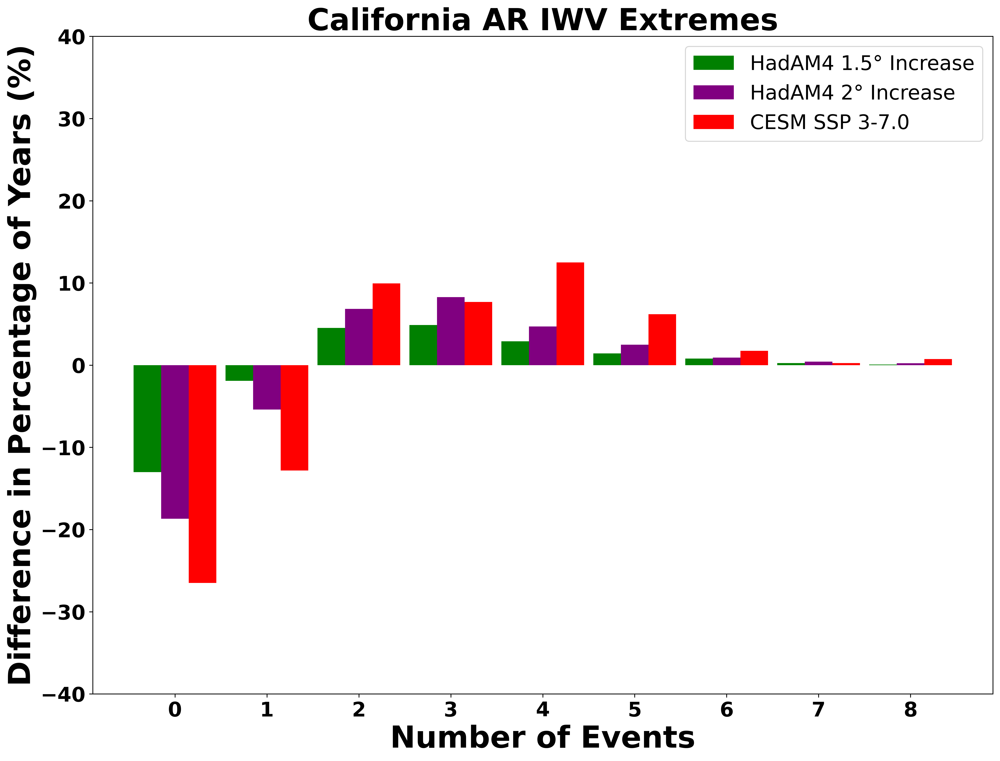

In [82]:
figure(num=None, figsize=(16, 12), dpi=450, facecolor='w', edgecolor='k')

x = np.arange(9)

plt.bar(x-.3,np.array(whome1_5ciwv)-np.array(whomehistiwv),.3,label = "HadAM4 1.5° Increase",color='Green')

plt.bar(x,np.array(whome2ciwv)-np.array(whomehistiwv),.3,label = "HadAM4 2° Increase",color='Purple')

plt.bar(x+.3,np.array(cesmssp370iwv)-np.array(cesmhistiwv),.3,label = "CESM SSP 3-7.0",color='Red')

plt.ylabel('Difference in Percentage of Years (%)',weight='bold',size = 30)
plt.xlabel('Number of Events',weight='bold',size = 30)
plt.title('California AR IWV Extremes',weight='bold',size=30)
plt.yticks(weight='bold',size = 20)
plt.xticks(ticks=[0,1,2,3,4,5,6,7,8],weight='bold',size = 20)
plt.legend(prop={'size': 20})
plt.ylim([-40,40])

In [ ]:
#cmaskscesmhist = Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/cesmhistmasks.nc').variables['classmasks'][:,36:41,43]
#emaskscesmhist = Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/cesmhistmasks.nc').variables['eventmasks'][:,36:41,43]
#ariwvcesmhist = np.reshape(Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/CESMhist.nc').variables['TMQ'][:,:,36:41,43],[2880*40,27,8])

#cmaskscesmssp370 = Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/cesmssp370masks.nc').variables['classmasks'][:,36:41,43]
#emaskscesmssp370 = Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/cesmssp370masks.nc').variables['eventmasks'][:,36:41,43]
#ariwvcesmssp370 = np.reshape(Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/CESMhist.nc').variables['TMQ'][:,:,36:41,43],[2880*40,5])

# Load data from HadAM4
#cmaskshist = np.flip(Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/whomehistmasks.nc').variables['classmasks'][:],axis=1)[:,31:43,67]
#emaskshist = np.flip(Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/whomehistmasks.nc').variables['eventmasks'][:],axis=1)[:,31:43,67]
#ariwvhist = (np.reshape(np.flip(Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/whomehist.nc').variables['IWV'][:],axis=2)[:,:,31:43,67],[2889*360,12]))*cmasks1_5c

#cmasks1_5c = np.flip(Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/whome1_5masks.nc').variables['classmasks'][:],axis=1)[:,31:43,67]
#emasks1_5c = np.flip(Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/whome1_5masks.nc').variables['eventmasks'][:],axis=1)[:,31:43,67]
#ariwv1_5c = (np.reshape(np.flip(Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/whome1_5c.nc').variables['IWV'][:],axis=2)[:,:,31:43,67],[2006*360,12]))*cmasks1_5c

#cmasks2c = np.flip(Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/whome2masks.nc').variables['classmasks'][:],axis=1)[:,31:43,67]
#emasks2c = np.flip(Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/whome2masks.nc').variables['eventmasks'][:],axis=1)[:,31:43,67]
#ariwv2c = (np.reshape(np.flip(Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/whome2c.nc').variables['IWV'][:],axis=2)[:,:,31:43,67],[1882*360,12]))*cmasks2c

In [85]:
ariwvcesmhist = np.reshape(Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/nature_cc/cesmhistariwv.nc').variables['AR_IWV'][:,:,9:17,0],[2880*40,8])
emaskscesmhist = np.reshape(Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/nature_cc/cesmhistariwv.nc').variables['event_masks'][:,:,9:17,0],[2880*40,8])

ariwvcesmssp370 = np.reshape(Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/nature_cc/cesmssp370ariwv.nc').variables['AR_IWV'][:,:,9:17,0],[2880*50,8])
emaskscesmssp370 = np.reshape(Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/nature_cc/cesmssp370ariwv.nc').variables['event_masks'][:,:,9:17,0],[2880*50,8])

In [108]:
emaskswhomehist = Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/nature_cc/histariwv.nc').variables['event_masks'][:,:,17:,0]
ariwvwhomehist = Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/nature_cc/histariwv.nc').variables['AR_IWV'][:,:,17:,0]

emaskswhome1_5c = Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/nature_cc/1_5ariwv.nc').variables['event_masks'][:,:,17:,0]
ariwvwhome1_5c = Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/nature_cc/1_5ariwv.nc').variables['AR_IWV'][:,:,17:,0]

emaskswhome2c = Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/nature_cc/2ariwv.nc').variables['event_masks'][:,:,17:,0]
ariwvwhome2c = Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/nature_cc/2ariwv.nc').variables['AR_IWV'][:,:,17:,0]

In [109]:
# Compute severity of all events
uniqueeventsssp370 = np.unique(emaskscesmssp370)
max_iwvssp370 = np.zeros([len(uniqueeventsssp370)-1])
i = 1
while i < len(uniqueeventsssp370):
	max_iwvssp370[i-1] = np.max(ariwvcesmssp370[emaskscesmssp370==uniqueeventsssp370[i]])
	i+=1
i = 0
number_of_years = np.shape(emaskscesmssp370)[0]/360
iwv_upper_limit = int(np.floor(np.max(max_iwvssp370)))
pnwssp370 = np.zeros([iwv_upper_limit])
while i < iwv_upper_limit:
	pnwssp370[i] = number_of_years/len(max_iwvssp370[max_iwvssp370>=i])
	i+=1

In [110]:
#repeat for HIST
uniqueeventshist = np.unique(emaskscesmhist)
max_iwvhist = np.zeros([len(uniqueeventshist)-1])
i = 1
while i < len(uniqueeventshist):
	max_iwvhist[i-1] = np.max(ariwvcesmhist[emaskscesmhist==uniqueeventshist[i]])
	i+=1
i = 0
number_of_years = np.shape(emaskscesmhist)[0]/360
iwv_upper_limit = int(np.floor(np.max(max_iwvhist)))
pnwhist = np.zeros([iwv_upper_limit])
while i < iwv_upper_limit:
	pnwhist[i] = number_of_years/len(max_iwvhist[max_iwvhist>=i])
	i+=1

In [111]:
# Compute severity of all events
uniqueeventswhomehist = np.unique(emaskswhomehist)
max_iwvwhomehist = np.zeros([len(uniqueeventswhomehist)-1])
i = 1
while i < len(uniqueeventswhomehist):
	max_iwvwhomehist[i-1] = np.max(ariwvwhomehist[emaskswhomehist==uniqueeventswhomehist[i]])
	i+=1
i = 0
number_of_years = np.shape(emaskswhomehist)[0]
iwv_upper_limit = int(np.floor(np.max(max_iwvwhomehist)))
pnwwhomehist = np.zeros([iwv_upper_limit])
while i < iwv_upper_limit:
	pnwwhomehist[i] = number_of_years/len(max_iwvwhomehist[max_iwvwhomehist>=i])
	i+=1

In [112]:
# Compute severity of all events
uniqueeventswhome1_5c = np.unique(emaskswhome1_5c)
max_iwvwhome1_5c = np.zeros([len(uniqueeventswhome1_5c)-1])
i = 1
while i < len(uniqueeventswhome1_5c):
	max_iwvwhome1_5c[i-1] = np.max(ariwvwhome1_5c[emaskswhome1_5c==uniqueeventswhome1_5c[i]])
	i+=1
i = 0
number_of_years = np.shape(emaskswhome1_5c)[0]
iwv_upper_limit = int(np.floor(np.max(max_iwvwhome1_5c)))
pnwwhome1_5c = np.zeros([iwv_upper_limit])
while i < iwv_upper_limit:
	pnwwhome1_5c[i] = number_of_years/len(max_iwvwhome1_5c[max_iwvwhome1_5c>=i])
	i+=1

In [113]:
# Compute severity of all events
uniqueeventswhome2c = np.unique(emaskswhome2c)
max_iwvwhome2c = np.zeros([len(uniqueeventswhome2c)-1])
i = 1
while i < len(uniqueeventswhome2c):
	max_iwvwhome2c[i-1] = np.max(ariwvwhome2c[emaskswhome2c==uniqueeventswhome2c[i]])
	i+=1
i = 0
number_of_years = np.shape(emaskswhome2c)[0]
iwv_upper_limit = int(np.floor(np.max(max_iwvwhome2c)))
pnwwhome2c = np.zeros([iwv_upper_limit])
while i < iwv_upper_limit:
	pnwwhome2c[i] = number_of_years/len(max_iwvwhome2c[max_iwvwhome2c>=i])
	i+=1

## Figure 1b

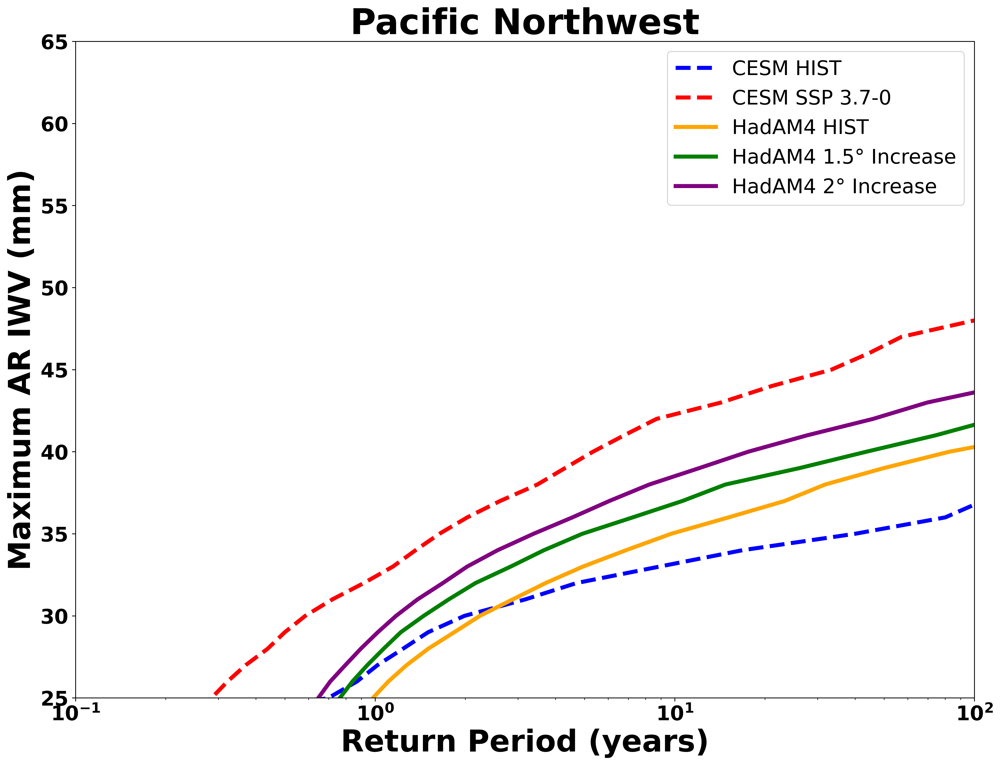

In [114]:
figure(num=None, figsize=(16, 12), dpi=450, facecolor='w', edgecolor='k')
x1 = np.arange(len(pnwwhomehist))
x = np.arange(len(pnwssp370))
x3 = np.arange(len(pnwwhome1_5c))
x2 = np.arange(len(pnwhist))
x4 = np.arange(len(pnwwhome2c))
plt.plot(pnwhist,x2,linewidth = 4, label = "CESM HIST", color = "Blue",linestyle="--")
plt.plot(pnwssp370,x,linewidth = 4, label = "CESM SSP 3.7-0", color = "Red",linestyle="--")
plt.plot(pnwwhomehist,x1,linewidth = 4, label = "HadAM4 HIST", color = "Orange")

plt.plot(pnwwhome1_5c,x3,linewidth = 4, label = "HadAM4 1.5° Increase", color = "Green")

plt.plot(pnwwhome2c,x4,linewidth = 4, label = "HadAM4 2° Increase", color = "Purple")



plt.xscale("log")
plt.title("Pacific Northwest",weight='bold',size = 35)
plt.xlabel("Return Period (years)",weight='bold',size = 30)
plt.ylabel("Maximum AR IWV (mm)",weight='bold',size = 30)
plt.xlim([0.1,100])
plt.ylim([25,65])
plt.yticks(weight='bold',size = 20)
plt.xticks(weight='bold',size = 20)
plt.legend(prop={'size': 20})

In [115]:
number_of_yearshist = np.shape(emaskscesmhist)[0]/360

seasonal_events = np.zeros([int(number_of_yearshist)])
i = 0
while i < int(number_of_yearshist):
	idx = np.where(np.max(ariwvcesmhist[i*360:(i+1)*360,:],axis=1)>sorted(max_iwvhist)[(-1)*int(number_of_yearshist)])[0]
	seasonal_events[i] = len(np.unique(emaskscesmhist[i*360:(i+1)*360,:][idx,:]))
	i+=1
Seasonaliwvcesmpnwhist = Counter(seasonal_events)
cesmhistiwv = np.array([Seasonaliwvcesmpnwhist[0],Seasonaliwvcesmpnwhist[2],Seasonaliwvcesmpnwhist[3],Seasonaliwvcesmpnwhist[4],Seasonaliwvcesmpnwhist[5],Seasonaliwvcesmpnwhist[6],Seasonaliwvcesmpnwhist[7],Seasonaliwvcesmpnwhist[8],Seasonaliwvcesmpnwhist[9]])*100/number_of_yearshist

In [116]:
number_of_years = np.shape(emaskscesmssp370)[0]/360

seasonal_events = np.zeros([int(number_of_years)])
i = 0
while i < int(number_of_years):
	idx = np.where(np.max(ariwvcesmssp370[i*360:(i+1)*360,:],axis=1)>sorted(max_iwvhist)[(-1)*int(number_of_yearshist)])[0]
	seasonal_events[i] = len(np.unique(emaskscesmssp370[i*360:(i+1)*360,:][idx,:]))
	i+=1
Seasonaliwvcesmpnwssp370 = Counter(seasonal_events)
cesmssp370iwv = np.array([Seasonaliwvcesmpnwssp370[0],Seasonaliwvcesmpnwssp370[2],Seasonaliwvcesmpnwssp370[3],Seasonaliwvcesmpnwssp370[4],Seasonaliwvcesmpnwssp370[5],Seasonaliwvcesmpnwssp370[6],Seasonaliwvcesmpnwssp370[7],Seasonaliwvcesmpnwssp370[8],Seasonaliwvcesmpnwssp370[9]])*100/number_of_years

In [123]:
number_of_yearshist = np.shape(emaskswhomehist)[0]
ariwvwhomehist = np.reshape(ariwvwhomehist,[2889*360,12])
emaskswhomehist = np.reshape(emaskswhomehist,[2889*360,12])
seasonal_events = np.zeros([int(number_of_yearshist)])

i = 0
while i < int(number_of_yearshist):
	idx = np.where(np.max(ariwvwhomehist[i*360:(i+1)*360,:],axis=1)>sorted(max_iwvwhomehist)[(-1)*int(number_of_yearshist)])[0]
	seasonal_events[i] = len(np.unique(emaskswhomehist[i*360:(i+1)*360,:][idx,:]))
	i+=1
Seasonaliwvwhomepnwhist = Counter(seasonal_events)
whomehistiwv = np.array([Seasonaliwvwhomepnwhist[0],Seasonaliwvwhomepnwhist[2],Seasonaliwvwhomepnwhist[3],Seasonaliwvwhomepnwhist[4],Seasonaliwvwhomepnwhist[5],Seasonaliwvwhomepnwhist[6],Seasonaliwvwhomepnwhist[7],Seasonaliwvwhomepnwhist[8],Seasonaliwvwhomepnwhist[9]])*100/number_of_yearshist

In [124]:
number_of_years = np.shape(emaskswhome1_5c)[0]
ariwvwhome1_5c = np.reshape(ariwvwhome1_5c,[2006*360,12])
emaskswhome1_5c = np.reshape(emaskswhome1_5c,[2006*360,12])
seasonal_events = np.zeros([int(number_of_years)])
i = 0
while i < int(number_of_years):
	idx = np.where(np.max(ariwvwhome1_5c[i*360:(i+1)*360,:],axis=1)>sorted(max_iwvwhomehist)[(-1)*int(number_of_yearshist)])[0]
	seasonal_events[i] = len(np.unique(emaskswhome1_5c[i*360:(i+1)*360,:][idx,:]))
	i+=1
Seasonaliwvwhomepnw1_5c = Counter(seasonal_events)
whome1_5ciwv = np.array([Seasonaliwvwhomepnw1_5c[0],Seasonaliwvwhomepnw1_5c[2],Seasonaliwvwhomepnw1_5c[3],Seasonaliwvwhomepnw1_5c[4],Seasonaliwvwhomepnw1_5c[5],Seasonaliwvwhomepnw1_5c[6],Seasonaliwvwhomepnw1_5c[7],Seasonaliwvwhomepnw1_5c[8],Seasonaliwvwhomepnw1_5c[9]])*100/number_of_years

In [125]:
number_of_years = np.shape(emaskswhome2c)[0]
ariwvwhome2c = np.reshape(ariwvwhome2c,[1882*360,12])
emaskswhome2c = np.reshape(emaskswhome2c,[1882*360,12])
seasonal_events = np.zeros([int(number_of_years)])
i = 0
while i < int(number_of_years):
	idx = np.where(np.max(ariwvwhome2c[i*360:(i+1)*360,:],axis=1)>sorted(max_iwvwhomehist)[(-1)*int(number_of_yearshist)])[0]
	seasonal_events[i] = len(np.unique(emaskswhome2c[i*360:(i+1)*360,:][idx,:]))
	i+=1
Seasonaliwvwhomepnw2c = Counter(seasonal_events)
whome2ciwv = np.array([Seasonaliwvwhomepnw2c[0],Seasonaliwvwhomepnw2c[2],Seasonaliwvwhomepnw2c[3],Seasonaliwvwhomepnw2c[4],Seasonaliwvwhomepnw2c[5],Seasonaliwvwhomepnw2c[6],Seasonaliwvwhomepnw2c[7],Seasonaliwvwhomepnw2c[8],Seasonaliwvwhomepnw2c[9]])*100/number_of_years

## Figure 2b

(-40.0, 40.0)

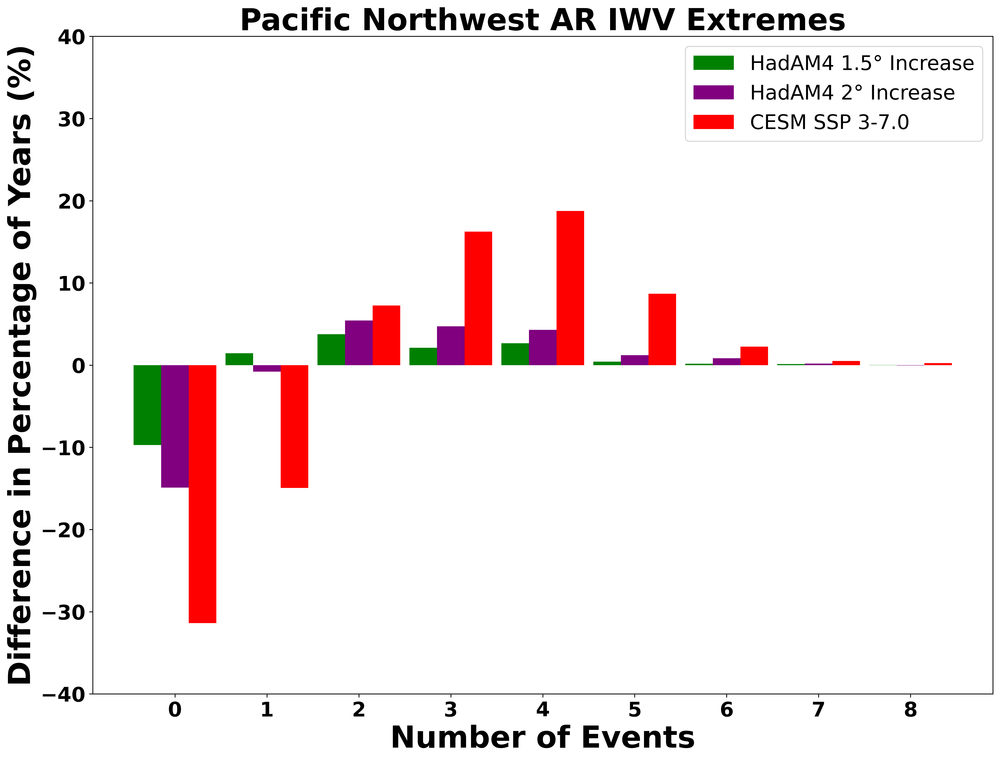

In [126]:
figure(num=None, figsize=(16, 12), dpi=450, facecolor='w', edgecolor='k')

x = np.arange(9)

plt.bar(x-.3,np.array(whome1_5ciwv)-np.array(whomehistiwv),.3,label = "HadAM4 1.5° Increase",color='Green')

plt.bar(x,np.array(whome2ciwv)-np.array(whomehistiwv),.3,label = "HadAM4 2° Increase",color='Purple')

plt.bar(x+.3,np.array(cesmssp370iwv)-np.array(cesmhistiwv),.3,label = "CESM SSP 3-7.0",color='Red')

plt.ylabel('Difference in Percentage of Years (%)',weight='bold',size = 30)
plt.xlabel('Number of Events',weight='bold',size = 30)
plt.title('Pacific Northwest AR IWV Extremes',weight='bold',size=30)
plt.yticks(weight='bold',size = 20)
plt.xticks(ticks=[0,1,2,3,4,5,6,7,8],weight='bold',size = 20)
plt.legend(prop={'size': 20})
plt.ylim([-40,40])

In [127]:
#window_size = 20
#p1 = np.reshape(Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/whomehist.nc').variables['PSL'][:,:,:,:],[2889*360,118,95])
#p2 = np.reshape(Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/whome1_5c.nc').variables['PSL'][:,:,:,:],[2006*360,118,95])
#p3 = np.reshape(Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/whome2c.nc').variables['PSL'][:,:,:,:],[1882*360,118,95])
#p = np.concatenate([p1,p2,p3],axis=0)
#psm = np.apply_along_axis(lambda x: np.convolve(x, np.ones(window_size)/window_size, mode='same'), axis=1, arr=p)
#psm = np.flip(psm,axis=1)
#ds = xr.DataArray(psm,dims=["time","lat","lon"])
#psm = ds.to_netcdf('/glade/derecho/scratch/timothyh/data/MSLP_SOMsm5daywhome.nc')

In [128]:
#ds = xr.open_dataarray('/glade/derecho/scratch/timothyh/data/MSLP_SOMsm5daywhome.nc')

In [129]:
#subset = ds.where(
#         (ds['lat']<50) & (ds['lat']>0) & \
#         (ds['lon']>-10) & (ds['lon']<60), 
#         drop=True)
#subset.stack(new=("lat","lon")).shape

In [130]:
#subsetarray = subset.stack(new=("lat","lon")).values

In [131]:
#som_grid_rows = 1          # (y-axis)
#som_grid_columns = 5        # (x-axis)
#input_length = subsetarray.shape[1]    # using preprocessed data array; Number of the elements of the vectors in input.
#sigma = 0.5               # Spread of the neighborhood function, needs to be adequate to the dimensions of the map.
#learning_rate = 0.5       # initial learning rate (at the iteration t we have learning_rate(t) = learning_rate / (1 + t/T) where T is #num_iteration/2)
#decay_function = asymptotic_decay


#neighborhood_function = 'gaussian'


#topology = 'rectangular'                 # Topology of the map; Possible values: 'rectangular', 'hexagonal'
#activation_distance = 'euclidean'        # Distance used to activate the map; Possible values: 'euclidean', 'cosine', 'manhattan', 'chebyshev'
#random_seed = 1              

In [132]:
#som = MiniSom(
#            som_grid_rows,
#            som_grid_columns,
#            input_length,
#            sigma,
#            learning_rate,
#            decay_function,
#            neighborhood_function,
#            topology,
#            activation_distance,
#            random_seed) 

In [133]:
#def normalize_data(data):
#    """
#    Function for normalizing data prior to training using z-score
#    """
#    return (data - np.nanmean(data)) / np.nanstd(data)

In [134]:
#data = normalize_data(subsetarray)
#num_iteration = 100000
#random_order = True
#verbose = True

In [135]:
#som.train(
#        data,
#        num_iteration,
#        random_order,
#        verbose)

In [136]:
#keys = [i for i in product(range(som_grid_rows),range(som_grid_columns))]
#winmap = {key: [] for key in keys}

# grab the indices for the data within the SOM lattice
#for i, x in enumerate(data):
#    winmap[som.winner(x)].append(i)

In [137]:
#som_keys = list(winmap.keys())


In [138]:
#Save the calculated regimes
#idx1 = winmap[som_keys[0]]
#idx2 = winmap[som_keys[1]]
#idx3 = winmap[som_keys[2]]
#idx4 = winmap[som_keys[3]]
#idx5 = winmap[som_keys[4]]
#
#da1 = xr.DataArray(data = idx1, dims=['num'],
#                           coords={'num': list(np.arange(len(idx1)))},
#                                    name = "idx1")
#da2 = xr.DataArray(data = idx2, dims=['num'],
#                           coords={'num': list(np.arange(len(idx2)))},
#                                    name = "idx2")
#da3 = xr.DataArray(data = idx3, dims=['num'],
#                           coords={'num': list(np.arange(len(idx3)))},
#                                    name = "idx3")
#da4 = xr.DataArray(data = idx4, dims=['num'],
#                           coords={'num': list(np.arange(len(idx4)))},
#                                    name = "idx4")
#da5 = xr.DataArray(data = idx5, dims=['num'],
#                           coords={'num': list(np.arange(len(idx5)))},
#                                    name = "idx5")

#da = xr.merge([da1,da2,da3,da4,da5])
#outdir = '/glade/work/timothyh/data/'

#da.to_netcdf(outdir+"whomecalculatedsomsfiltered5day.nc")

In [139]:
#load in all mslp data and calculate anomaly
#psm = Dataset('/glade/derecho/scratch/timothyh/data/MSLP_SOMsm5daywhome.nc').variables['__xarray_dataarray_variable__'][:]
#psmanom = psm-np.mean(psm,axis=0)

In [140]:
#Load locations of any desired regime in the data
#idx1 = #np.array(Dataset('/glade/work/timothyh/data/whomecalculatedsomsfiltered5day.nc').variables['idx1'][:])
#idx1 = idx1[~np.isnan(idx1)].astype(int)

## Figure 3

/glade/work/timothyh/miniconda3/envs/analysis/lib/python3.8/site-packages/cartopy/mpl/gridliner.py:307: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/timothyh/miniconda3/envs/analysis/lib/python3.8/site-packages/cartopy/mpl/gridliner.py:343: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '


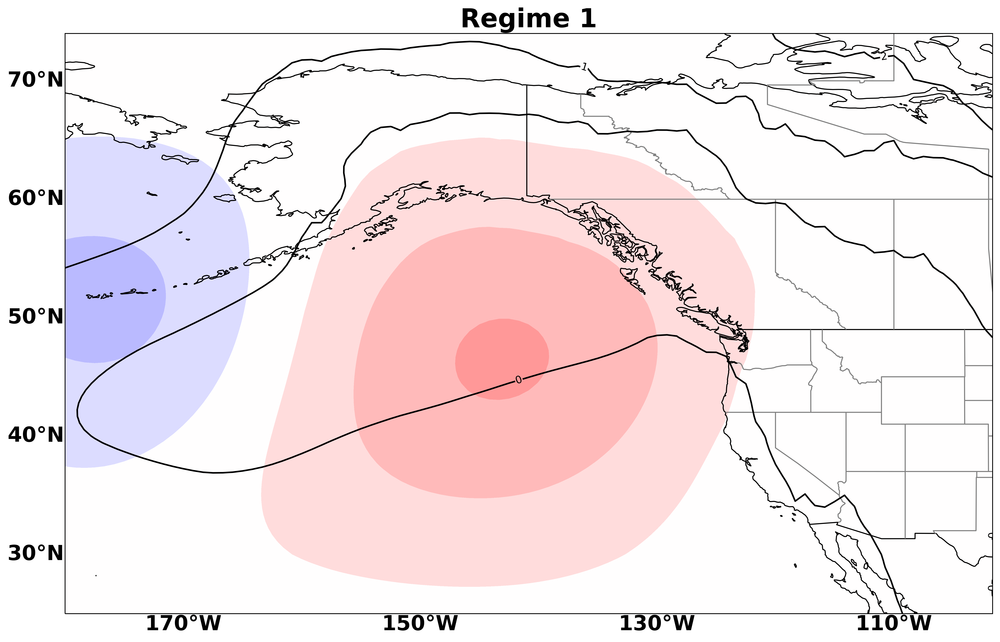

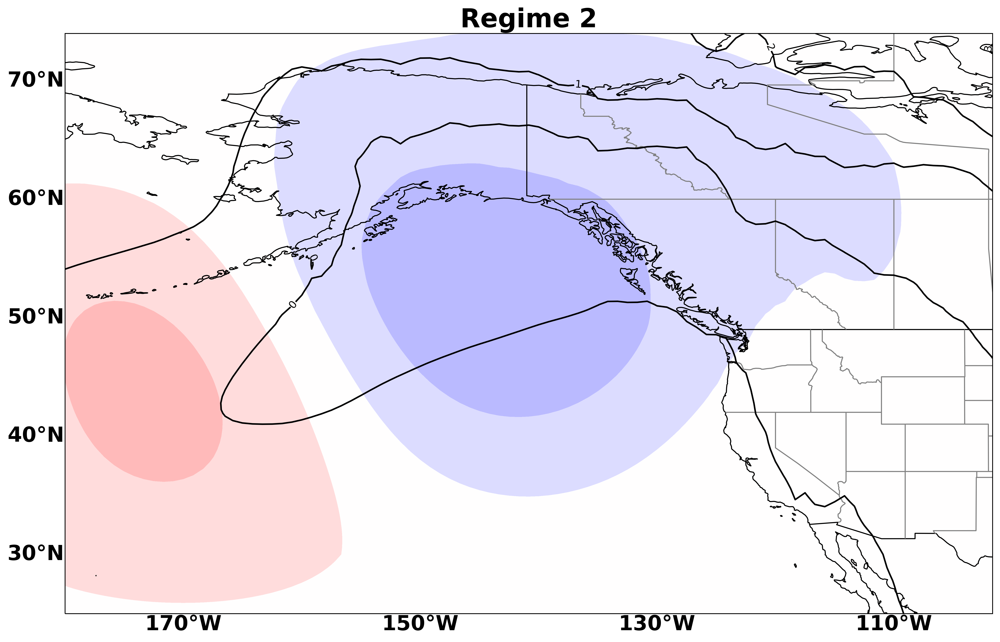

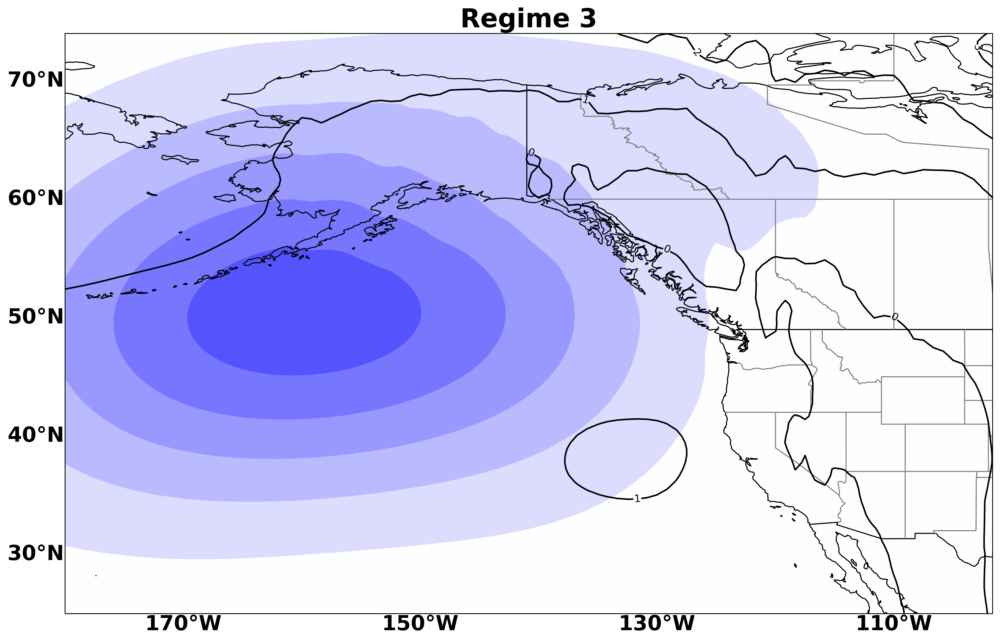

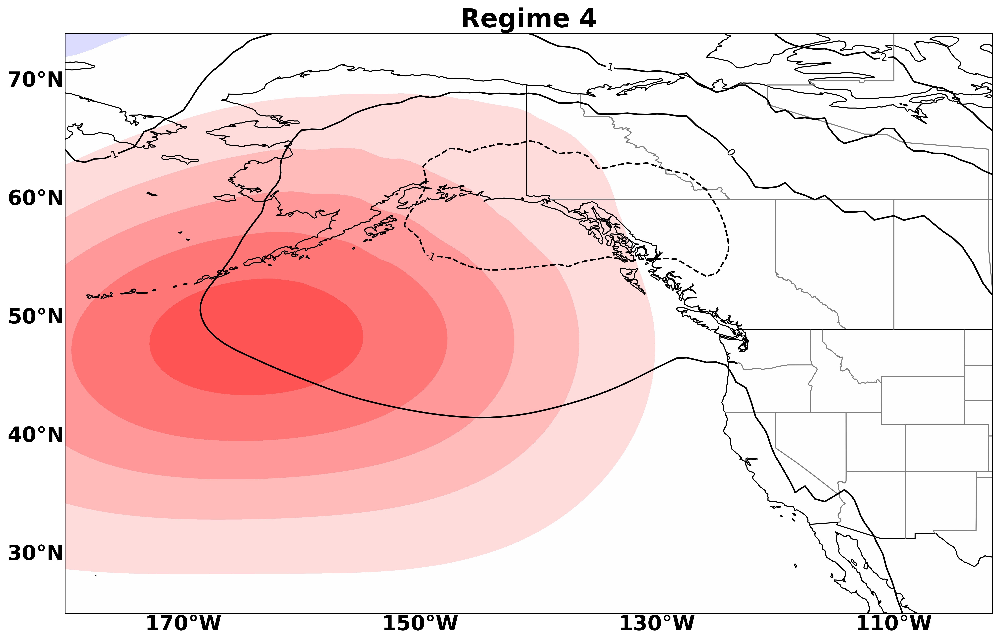

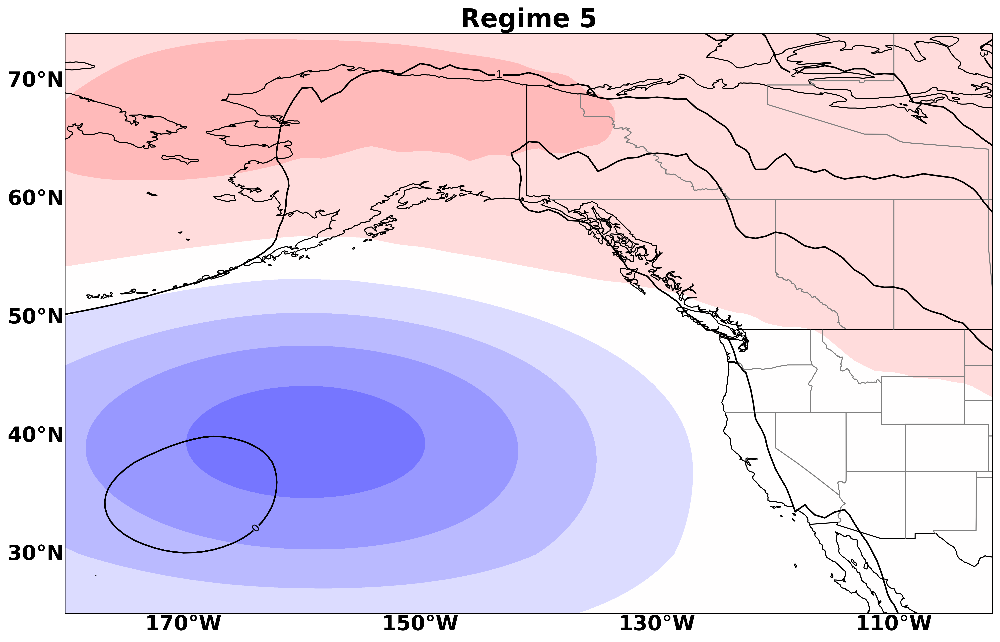

In [150]:
warnings.filterwarnings("ignore", category=DeprecationWarning)
file = '/glade/derecho/scratch/timothyh/data/weatherhome/completed/nature_cc/MSLPregimes.nc'
clevs = [-5,-4,-3,-2,-1,0,1,2,3,4,5]
conlevels = np.linspace(-30,30,num=16)

lat = Dataset(file).variables['lat'][:]
lon = Dataset(file).variables['lon'][:]

for i in range(5):
    #idx = #np.array(Dataset('/glade/work/timothyh/data/whomecalculatedsomsfiltered5day.nc').variables['idx'+str(i+1)][:])
    #idx = idx[~np.isnan(idx)].astype(int)
    #anom = np.mean(psmanom[idx,:90,:],axis=0)/100
    #change = (np.mean(psm[idx[idx<1040040],:90,:],axis=0)-(np.mean(psm[idx[idx1>1762200],:90,:],axis=0)))/100
    figure(num=None, figsize=(16, 12), dpi=450, facecolor='w', edgecolor='k')
    ax = plt.axes(projection = ccrs.PlateCarree(central_longitude= -102.5,globe=None))
    colormap = plt.cm.get_cmap('bwr') 
    anom = Dataset(file).variables['MSLP_Anom_Regime'+str(i+1)][:]
    change = Dataset(file).variables['MSLP_Change_Regime'+str(i+1)][:]
    plt.contourf(lon[:],lat[:90],anom,conlevels,
			transform=ccrs.PlateCarree(), extend = 'both',cmap=colormap)
    cs = ax.contour(lon[:],lat[:90],change,clevs,
			transform=ccrs.PlateCarree(),colors = 'black')
    def fmt(x):
    	s = f"{x:.1f}"
    	if s.endswith("0"):
    		s = f"{x:.0f}"
    	return rf"{s}" if plt.rcParams["text.usetex"] else f"{s}"
    ax.add_feature(cfeature.LAND)
    ax.add_feature(cfeature.COASTLINE)
    ax.add_feature(cfeature.BORDERS)
    states_provinces = cfeature.NaturalEarthFeature(
		category='cultural',
		name='admin_1_states_provinces_lines',
		scale='50m',
		facecolor='none')
    SOURCE = 'Natural Earth'
    LICENSE = 'public domain'
    ax.add_feature(states_provinces, edgecolor='gray')
    ax.set_ylim(top=74)

    gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
				  linewidth=0, color='gray', alpha=0.5)
    gl.xlabel_style = {'size': 20, 'weight': 'bold'}
    gl.ylabel_style = {'size': 20, 'weight': 'bold'}
    gl.xlabels_top = False
    gl.ylabels_right = False
    gl.xlocator = matplotlib.ticker.FixedLocator([-190,-170,-150,-130,-110])
    gl.ylocator = matplotlib.ticker.FixedLocator([30,40,50,60,70])
    ax.clabel(cs,[-5,-4,-3,-2,-1,0,1,2,3,4,5], inline=True, fmt=fmt, fontsize=10)

    plt.title('Regime '+str(i+1),weight = 'bold',fontsize = 25)#1.5\N{DEGREE SIGN}C Increase')
    plt.plot()


In [151]:
# Define coastline in HadAM4

whomecalicoast = np.zeros([32,9])
whomecalicoast[17:29,0] = 1
whomecalicoast[12:17,0] = 1
whomecalicoast[10:12,1] = 1
whomecalicoast[7:10,2] = 1
whomecalicoast[6,3] = 1
whomecalicoast[3:6,4] = 1
whomecalicoast[3,4:6] = 1
whomecalicoast[2,6:8] = 1
whomecalicoast[0:2,8] = 1


In [3]:
#calculate AR IWV
#cmaskshist = np.flip(Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/whomehistmasks.nc').variables['classmasks'][:],axis=1)[:,14:46,67:76]*whomecalicoast
#ariwvhist = (np.reshape(np.flip(Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/whomehist.nc').variables['IWV'][:],axis=2)[:,:,14:46,67:76],[2889*360,32,9]))*cmaskshist

#cmasks15 = np.flip(Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/whome1_5masks.nc').variables['classmasks'][:],axis=1)[:,14:46,67:76]*whomecalicoast
#ariwv15 = (np.reshape(np.flip(Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/whome1_5c.nc').variables['IWV'][:],axis=2)[:,:,14:46,67:76],[2006*360,32,9]))*cmasks15

#cmasks2 = np.flip(Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/whome2masks.nc').variables['classmasks'][:],axis=1)[:,14:46,67:76]*whomecalicoast
#ariwv2 = (np.reshape(np.flip(Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/whome2c.nc').variables['IWV'][:],axis=2)[:,:,14:46,67:76],[1882*360,32,9]))*cmasks2
#ariwv = np.concatenate([ariwvhist,ariwv15,ariwv2],axis=0)

In [ ]:
#compute locations of extreme events
#idx = np.where(np.max(ariwv,axis=(1,2))>sorted(max_iwv)[(-1)*int(number_of_years))

In [ ]:
#save locations in data of extreme events
#ds = xr.DataArray((idx[0]))
#ds.to_netcdf('/glade/work/timothyh/data/coastextremeidx.nc')

In [9]:
(2889*360)+(2006*360)

1762200

In [153]:
#load in locations in the data of extreme events and weather regimes, find locations where any given regime intersects with extreme events
#xars = Dataset('/glade/work/timothyh/data/coastextremeidx.nc').variables['__xarray_dataarray_variable__'][:]

#idxregime = Dataset('/glade/work/timothyh/data/whomecalculatedsomsfiltered5day.nc').variables['idx1'][:]
#xregime = np.array(idxregime[~pd.isnull(idxregime)]).astype(int)

#idxint = np.intersect1d(xars,xregime)
#i = 0
#while i < len(idxint)-1:
#	if idxint[i+1] == idxint[i]+1:
#		idxint[i] = 1140040
#	i+=1
#idxhist = idxint[idxint<1040040]
#idx2c = idxint[idxint>1762200]
#warnings.filterwarnings("ignore", category=DeprecationWarning)

In [12]:
#cmaskshist = np.flip(Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/whomehistmasks.nc').variables['classmasks'][idxhist,:,:],axis=1)
#cmasks2c = np.flip(Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/whome2masks.nc').variables['classmasks'][idx2c-1762200,:,:],axis=1)

In [13]:
#cmaskshistall = np.flip(Dataset('/glade/derecho/scratch/timothyh/data/weatherhome/completed/whomehistmasks.nc').variables['classmasks'][:],axis=1)[:,:,:]

In [154]:
#percentage of events in the regime from each scenario
#a = len(idxregime[idxregime<1040040])
#b = len(idxregime[idxregime>1762200])
#print(a/1040040)
#print((len(idxregime[idxregime>0])-a-b)/722160)
#print(b/677520)
#idxhistpct = len(idxregime[idxregime<1040040])/1040040
#idx2cpct = len(idxregime[idxregime>1762200])/677520

0.258501596092458
0.2473385399357483
0.2455056677293659


In [155]:
# this gives number of events from hist in regime, number of events from 2c in regime, and percentage increase (accounting for sample size)
print(len(idxhist))
print(len(idx2c))
print(((len(idx2c)/1882)-(len(idxhist)/2889))/(len(idxhist)/2889))

255
298
0.7939238607238857


In [15]:
#Use bootstrapping to determine significance
#Num_samples = cmaskshistall.shape[0]
#x = np.arange(cmaskshistall.shape[0])

#Nbs = 1000
#P_Bootstrap=np.zeros([1000,118,95])

#for ii in range(Nbs):
#    idx = np.random.choice(x,Num_samples)
#    idxidx = np.isin(idx,idxint)#np.intersect1d(idx,idxint)
#    sel_ars = idx[idxidx]
#    P_Bootstrap[ii,:,:] = (1/idxhistpct)*(np.sum(cmaskshistall[sel_ars,:,:],axis=0)/2889)



In [ ]:
#Bootthresh = np.zeros([118,95])
#i = 0
#while i < 118:
#	j = 0
#	while j < 95:
#		Bootthresh[i,j] = (np.sqrt(Nbs))*(((np.sum(cmasks2c[:,i,j],axis=0)/1882)/idx2cpct)-np.mean(P_Bootstrap[:,i,j]))/(np.std(P_Bootstrap[:,i,j]))
#		j+=1
#	i+=1

<ipython-input-16-19631d6554cf>:6: RuntimeWarning: divide by zero encountered in double_scalars
  Bootthresh[i,j] = (np.sqrt(Nbs))*(((np.sum(cmasks2c[:,i,j],axis=0)/1882)/idx2cpct)-np.mean(P_Bootstrap[:,i,j]))/(np.std(P_Bootstrap[:,i,j]))
<ipython-input-16-19631d6554cf>:6: RuntimeWarning: invalid value encountered in double_scalars
  Bootthresh[i,j] = (np.sqrt(Nbs))*(((np.sum(cmasks2c[:,i,j],axis=0)/1882)/idx2cpct)-np.mean(P_Bootstrap[:,i,j]))/(np.std(P_Bootstrap[:,i,j]))


In [ ]:
#x2 = np.sum(cmasks2c,axis=0)#/idx2cpct
#x1 = np.sum(cmaskshist,axis=0)#/idxhistpct

In [157]:
f1 = '/glade/derecho/scratch/timothyh/data/weatherhome/completed/nature_cc/regime1ARs.nc'

lat = Dataset(f1).variables['lat'][:]
lon = Dataset(f1).variables['lon'][:]

In [ ]:
#da1 = xr.DataArray(data = x2, dims=['lat','lon'],
#                       coords={'lat': list(lat[:]),
#							   'lon': list(lon[:])},
#				   name = "ARtotal_2c")
#
#da2 = xr.DataArray(data = x1, dims=['lat','lon'],
#                       coords={'lat': list(lat[:]),
#							   'lon': list(lon[:])},
#				   name = "ARtotal_hist")
#da3 = xr.DataArray(data = Bootthresh, dims=['lat','lon'],
#                       coords={'lat': list(lat[:]),
#							   'lon': list(lon[:])},
#				   name = "Bootstrapping_threshold")


#da = xr.merge([da1,da2,da3])
#outdir = '/glade/derecho/scratch/timothyh/data/weatherhome/completed/nature_cc/'
#da.to_netcdf(outdir+'regime1ARs.nc')

In [168]:
np.max(freqchange)

1.0749336408234316

## Figure 4

255
298
0.7939238607238857
823
1049
0.9566068774590253


/glade/work/timothyh/miniconda3/envs/analysis/lib/python3.8/site-packages/cartopy/mpl/gridliner.py:307: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/timothyh/miniconda3/envs/analysis/lib/python3.8/site-packages/cartopy/mpl/gridliner.py:343: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '


701
1035
1.2664714594756847
598
688
0.766099538312263
855
1135
1.0377817551317188


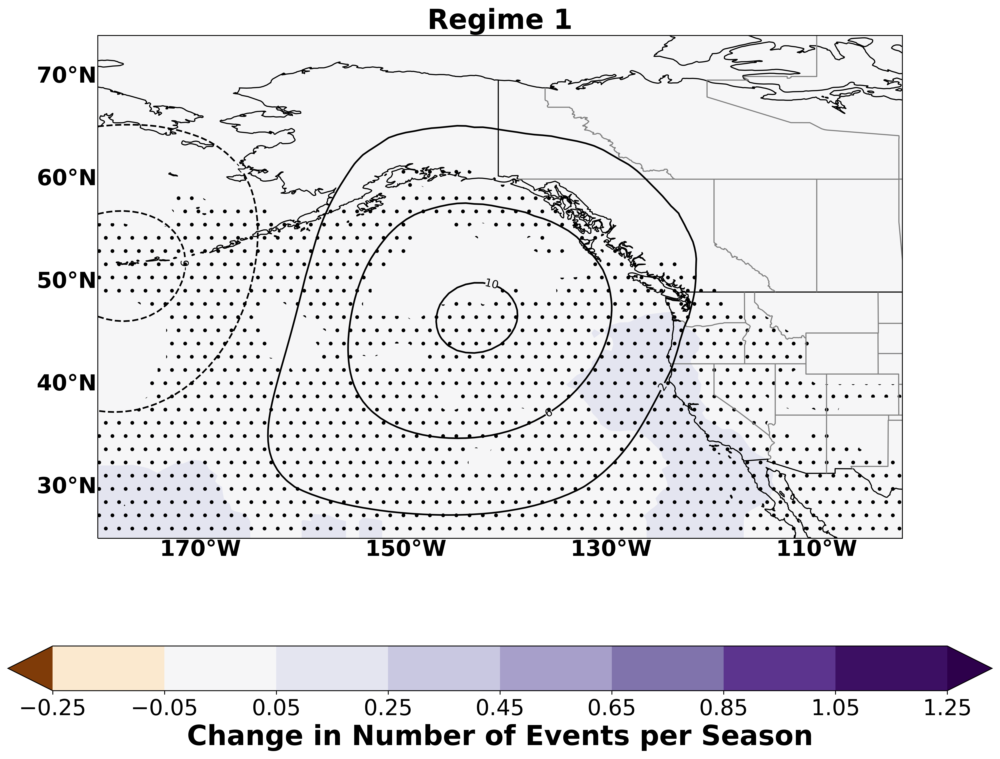

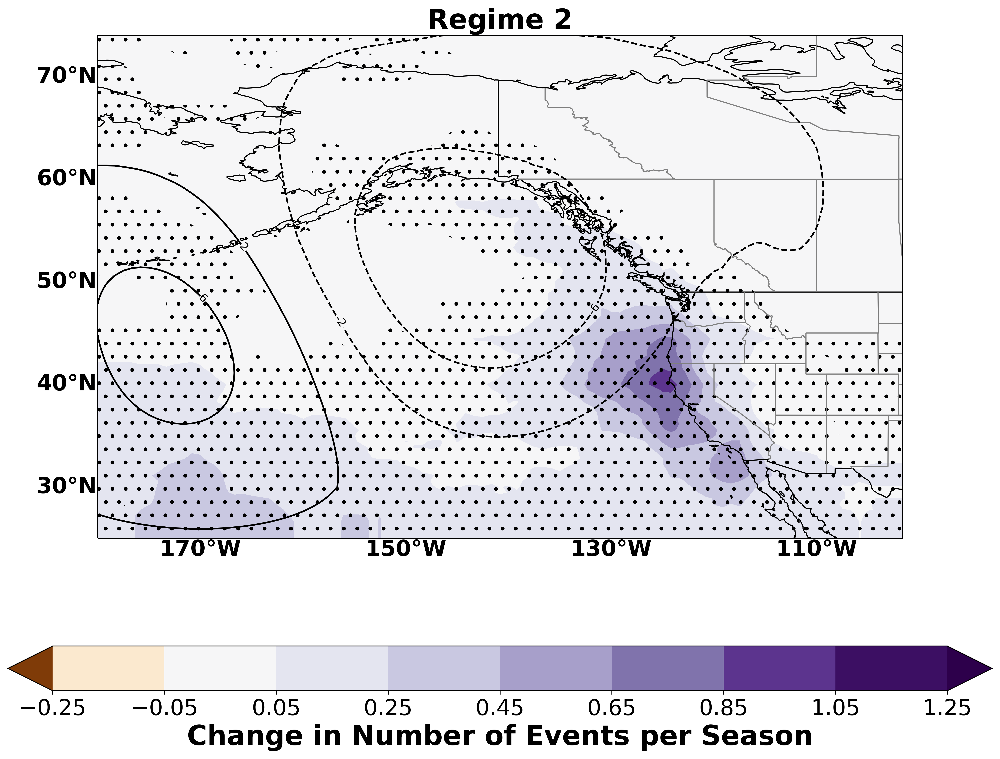

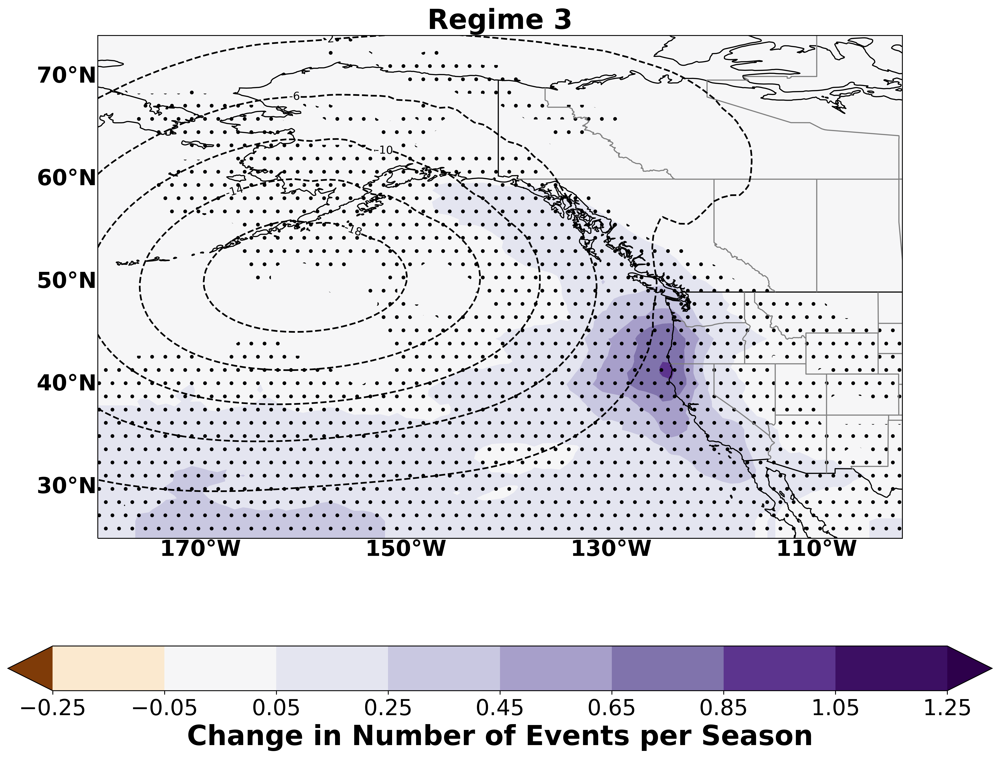

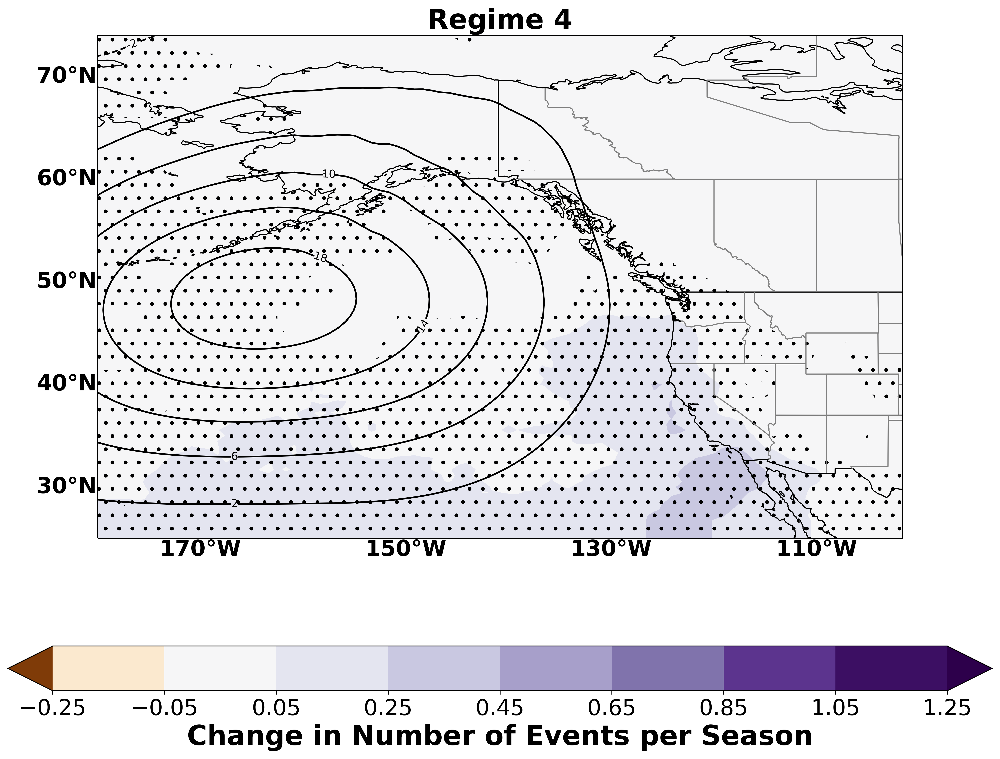

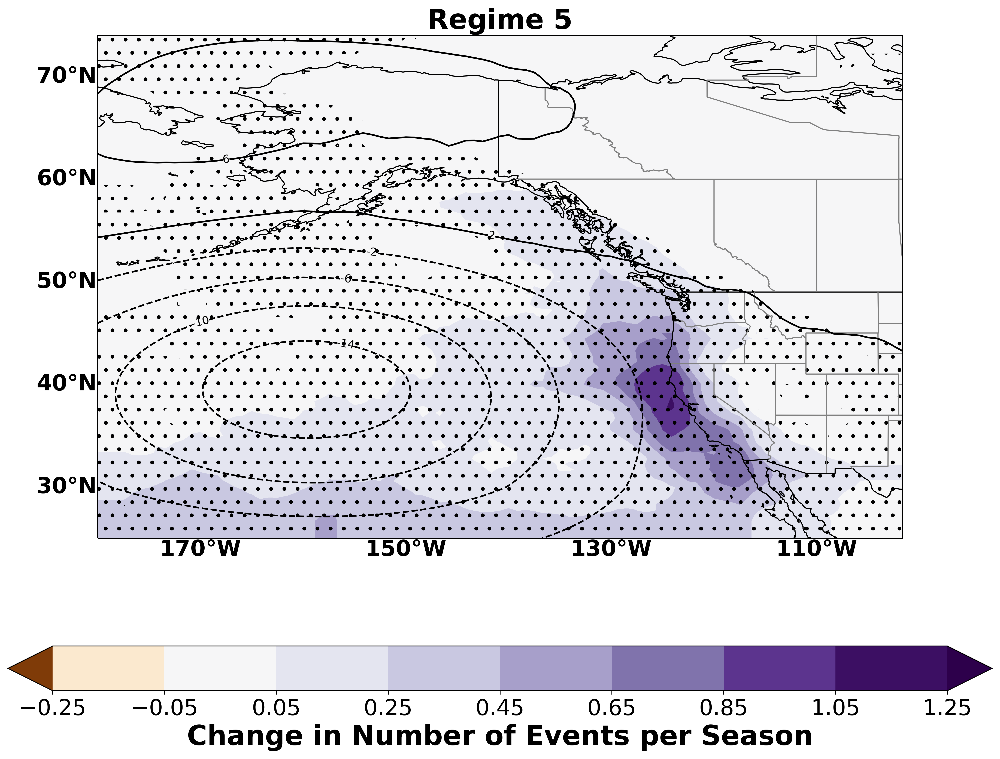

In [173]:
f1 = '/glade/derecho/scratch/timothyh/data/weatherhome/completed/nature_cc/regime1ARs.nc'
warnings.filterwarnings("ignore", category=DeprecationWarning)
conlevels = [-.25,-.05,.05,.25,.45,.65,.85,1.05,1.25]
zconlevels = [2.228,1000]
#idxnan = np.array([float(x) if x != '--' else np.nan for x in idxregime])
#idx1 = idxnan[~np.isnan(idxnan)].astype(int)
clevs = np.linspace(-30,30,num=16)
lat = Dataset(f1).variables['lat'][:]
lon = Dataset(f1).variables['lon'][:]
for j in range(5):
    xars = Dataset('/glade/work/timothyh/data/coastextremeidx.nc').variables['__xarray_dataarray_variable__'][:]

    idxregime = Dataset('/glade/work/timothyh/data/whomecalculatedsomsfiltered5day.nc').variables['idx'+str(j+1)][:]
    xregime = np.array(idxregime[~pd.isnull(idxregime)]).astype(int)

    idxint = np.intersect1d(xars,xregime)
    i = 0
    while i < len(idxint)-1:
    	if idxint[i+1] == idxint[i]+1:
    		idxint[i] = 1140040
    	i+=1
    idxhist = idxint[idxint<1040040]
    idx2c = idxint[idxint>1762200]

    idxhistpct = len(idxregime[idxregime<1040040])/1040040
    idx2cpct = len(idxregime[idxregime>1762200])/677520
    print(len(idxhist))
    print(len(idx2c))
    print(((len(idx2c)/1882)-(len(idxhist)/2889))/(len(idxhist)/2889))
    figure(num=None, figsize=(16, 12), dpi=450, facecolor='w', edgecolor='k')
    ax = plt.axes(projection = ccrs.PlateCarree(central_longitude= -102.5,globe=None))
    colormap = plt.cm.get_cmap('PuOr') 
    #x2 = (np.sum(cmasks2c,axis=0)/1882)/idx2cpct
    #x1 = (np.sum(cmaskshist,axis=0)/2889)/idxhistpct
    #x = x2-x1
    vmin,vmax = -1.25,1.25
    file = '/glade/derecho/scratch/timothyh/data/weatherhome/completed/nature_cc/regime'+str(j+1)+'ARs.nc'
    fileregime = '/glade/derecho/scratch/timothyh/data/weatherhome/completed/nature_cc/MSLPregimes.nc'
    norm = TwoSlopeNorm(vmin=vmin, vcenter=0, vmax=vmax)
    anom = Dataset(fileregime).variables['MSLP_Anom_Regime'+str(j+1)][:]
    freqhist = Dataset(file).variables['ARtotal_hist'][:]/(idxhistpct*2889)
    freq2c = Dataset(file).variables['ARtotal_2c'][:]/(idx2cpct*1882)
    freqchange = freq2c-freqhist
    Bootthresh = Dataset(file).variables['Bootstrapping_threshold'][:]
    plt.contourf(lon[:],lat[:90],freqchange[:90,:],conlevels,
			transform=ccrs.PlateCarree(), extend = 'both', norm=norm, cmap=colormap)
    fs = ax.contourf(lon[:],lat[:90],Bootthresh[:90,:],zconlevels,hatches=["."],colors = 'none',transform=ccrs.PlateCarree())
    cs = ax.contour(lon[:],lat[:90],anom[:90,:],clevs,
			transform=ccrs.PlateCarree(),colors = 'black')
    #plt.contourf(lon[:],lat[:90],x[:90,:],conlevels,
	#		transform=ccrs.PlateCarree(), extend = 'both', norm=norm, cmap=colormap)
    #cs = ax.contour(lon[:],lat[:90],np.mean(psmanom[idx1,:90,:],axis=0)/100,clevs,
	#		transform=ccrs.PlateCarree(),colors = 'black')
    #fs = ax.contourf(lon[:],lat[:90],Bootthresh[:90,:],zconlevels,hatches=["."],colors = 'none',
	#		transform=ccrs.PlateCarree())
    def fmt(x):
    	s = f"{x:.1f}"
    	if s.endswith("0"):
    		s = f"{x:.0f}"
    	return rf"{s}" if plt.rcParams["text.usetex"] else f"{s}"
    ax.add_feature(cfeature.LAND)
    ax.add_feature(cfeature.COASTLINE)
    ax.add_feature(cfeature.BORDERS)
    states_provinces = cfeature.NaturalEarthFeature(
    		category='cultural',
    		name='admin_1_states_provinces_lines',
    		scale='50m',
    		facecolor='none')
    SOURCE = 'Natural Earth'
    LICENSE = 'public domain'
    ax.add_feature(states_provinces, edgecolor='gray')

    cbar = plt.colorbar(orientation='horizontal',ticks=[-.25,-.05,.05,.25,.45,.65,.85,1.05,1.25])
    cbar.ax.set_xlabel('Change in Number of Events per Season', fontsize = 25,rotation=0,weight='bold')
    cbar.ax.tick_params(labelsize=20) 

    #ax.clabel(cs,[-2,-1,0,1,2], inline=True, fmt=fmt, fontsize=10)
    gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
				  linewidth=0, color='gray', alpha=0.5)
    gl.xlabel_style = {'size': 20, 'weight': 'bold'}
    gl.ylabel_style = {'size': 20, 'weight': 'bold'}
    #gl.xlocator = ticker.FixedLocator([-135,-120])
    gl.xlabels_top = False
    gl.ylabels_right = False
    gl.xlocator = matplotlib.ticker.FixedLocator([-190,-170,-150,-130,-110])
    gl.ylocator = matplotlib.ticker.FixedLocator([30,40,50,60,70])
    ax.clabel(cs,[-30,-26,-22,-18,-14,-10,-6,-2,2,6,10,14,18,22,26,30], inline=True, fmt=fmt, fontsize=10)
    ax.set_ylim(top=74)

    plt.title('Regime '+str(j+1),weight = 'bold',fontsize = 25)#1.5\N{DEGREE SIGN}C Increase')
    plt.plot()



In [203]:
happitemp = Dataset('/glade/derecho/scratch/timothyh/data/HAPPI_20K_dSST_MMM_allmem_rcp26_rcp45_209101_210012_vs_rcp85_200601_201512_1DEG_monthly_1year.nc').variables['tos'][:]
lat = np.flip(Dataset('/glade/derecho/scratch/timothyh/data/HAPPI_15K_dSST_MMM_allmem_rcp26_209101_210012_vs_rcp85_200601_201512_1DEG_monthly_1year.nc').variables['lat'][:])
lon = Dataset('/glade/derecho/scratch/timothyh/data/HAPPI_15K_dSST_MMM_allmem_rcp26_209101_210012_vs_rcp85_200601_201512_1DEG_monthly_1year.nc').variables['lon'][:]

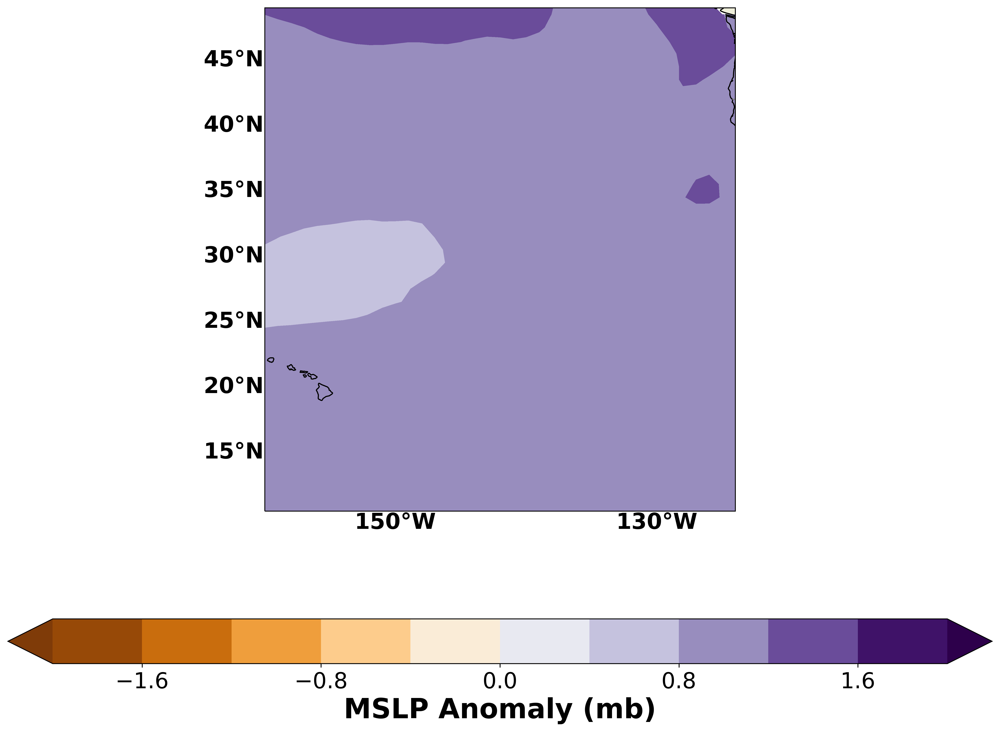

In [175]:
#mslp = np.reshape(Dataset(f1).variables['PSL'][:,120:,:,:],[48600,118,95])
conlevels = np.linspace(-2,2,11)
zconlevels = [2.228,1000]
clevs = np.linspace(-30,30,num=16)

figure(num=None, figsize=(16, 12), dpi=450, facecolor='w', edgecolor='k')
ax = plt.axes(projection = ccrs.PlateCarree(central_longitude= -102.5,globe=None))
colormap = plt.cm.get_cmap('PuOr') 

djftemp = (happitemp[11,:,:]+happitemp[0,:,:]+happitemp[1,:,:])/3
plt.contourf(lon[200:237],lat[100:140],djftemp[100:140,200:237],conlevels,
			transform=ccrs.PlateCarree(), extend = 'both', cmap=colormap)

ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.BORDERS)
states_provinces = cfeature.NaturalEarthFeature(
		category='cultural',
		name='admin_1_states_provinces_lines',
		scale='50m',
		facecolor='none')
SOURCE = 'Natural Earth'
LICENSE = 'public domain'
ax.add_feature(states_provinces, edgecolor='gray')

cbar = plt.colorbar(orientation='horizontal')
cbar.ax.set_xlabel('MSLP Anomaly (mb)', fontsize = 25,rotation=0,weight='bold')
cbar.ax.tick_params(labelsize=20) 

gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
				  linewidth=0, color='gray', alpha=0.5)
gl.xlabel_style = {'size': 20, 'weight': 'bold'}
gl.ylabel_style = {'size': 20, 'weight': 'bold'}
#gl.xlocator = ticker.FixedLocator([-135,-120])
gl.xlabels_top = False
gl.ylabels_right = False
gl.xlocator = matplotlib.ticker.FixedLocator([-190,-170,-150,-130,-110])
#gl.ylocator = matplotlib.ticker.FixedLocator([30,40,50,60,70])
#ax.clabel(cs,[-30,-26,-22,-18,-14,-10,-6,-2,2,6,10,14,18,22,26,30], inline=True, fmt=fmt, fontsize=10)
ax.set_ylim(top=49)

plt.plot()
warnings.filterwarnings("ignore", category=DeprecationWarning)


In [179]:
print("Change from HIST to 2C in HAPPI = "+str(np.mean(djftemp[100:140,200:237]))+" degrees")

Change from HIST to 2C in HAPPI = 1.013424513304508 degrees


In [196]:
#files1 = sorted([I for I in glob.glob('/glade/campaign/cgd/cesm/CESM2-LE/atm/proc/tseries/month_1/SST/b.e21.BHISTsmbb*200001-200912.nc')])
#files2 = sorted([I for I in glob.glob('/glade/campaign/cgd/cesm/CESM2-LE/atm/proc/tseries/month_1/SST/b.e21.BHISTsmbb*201001-201412.nc')])
#len(files1)
#THIST = np.zeros([50,156,192,288])
#i = 0
#while i < 50:
#    T00 = Dataset(files1[i]).variables['SST'][84:,:,:]
#    T10 = Dataset(files1[i]).variables['SST'][:]
#    THIST[i,:,:,:] = np.concatenate([T00,T10],axis=0)
#    i+=1


In [197]:
#files1 = sorted([I for I in glob.glob('/glade/campaign/cgd/cesm/CESM2-LE/atm/proc/tseries/month_1/SST/b.e21.BSSP370smbb*208501-209412.nc')])
#files2 = sorted([I for I in glob.glob('/glade/campaign/cgd/cesm/CESM2-LE/atm/proc/tseries/month_1/SST/b.e21.BSSP370smbb*209501-210012.nc')])
#len(files1)
#TSSP370 = np.zeros([50,156,192,288])
#i = 0
#while i < 50:
#    T00 = Dataset(files1[i]).variables['SST'][84:,:,:]
#    T10 = Dataset(files1[i]).variables['SST'][:]
#    TSSP370[i,:,:,:] = np.concatenate([T00,T10],axis=0)
#    i+=1

In [206]:
#x = Dataset('/glade/campaign/cgd/cesm/CESM2-LE/atm/proc/tseries/month_1/SST/b.e21.BSSP370smbb.f09_g17.LE2-1301.020.cam.h0.SST.209501-210012.nc').variables['SST'][:]
#lat = Dataset('/glade/campaign/cgd/cesm/CESM2-LE/atm/proc/tseries/month_1/SST/b.e21.BSSP370smbb.f09_g17.LE2-1301.020.cam.h0.SST.209501-210012.nc').variables['lat'][:]
#lon = Dataset('/glade/campaign/cgd/cesm/CESM2-LE/atm/proc/tseries/month_1/SST/b.e21.BSSP370smbb.f09_g17.LE2-1301.020.cam.h0.SST.209501-210012.nc').variables['lon'][:]
#x.shape

(72, 192, 288)

In [199]:
#dec = np.linspace(12,156,13).astype(int) - 1
#jan = np.linspace(12,156,13).astype(int) - 12
#feb = np.linspace(12,156,13).astype(int) - 11


In [200]:
#histdec = np.mean(THIST[:,dec,:,:],axis=(0,1))
#histjan = np.mean(THIST[:,jan,:,:],axis=(0,1))
#histfeb = np.mean(THIST[:,feb,:,:],axis=(0,1))


In [201]:
#ssp370dec = np.mean(TSSP370[:,dec,:,:],axis=(0,1))
#ssp370jan = np.mean(TSSP370[:,jan,:,:],axis=(0,1))
#ssp370feb = np.mean(TSSP370[:,feb,:,:],axis=(0,1))

/glade/work/timothyh/miniconda3/envs/analysis/lib/python3.8/site-packages/cartopy/mpl/gridliner.py:307: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/glade/work/timothyh/miniconda3/envs/analysis/lib/python3.8/site-packages/cartopy/mpl/gridliner.py:343: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '


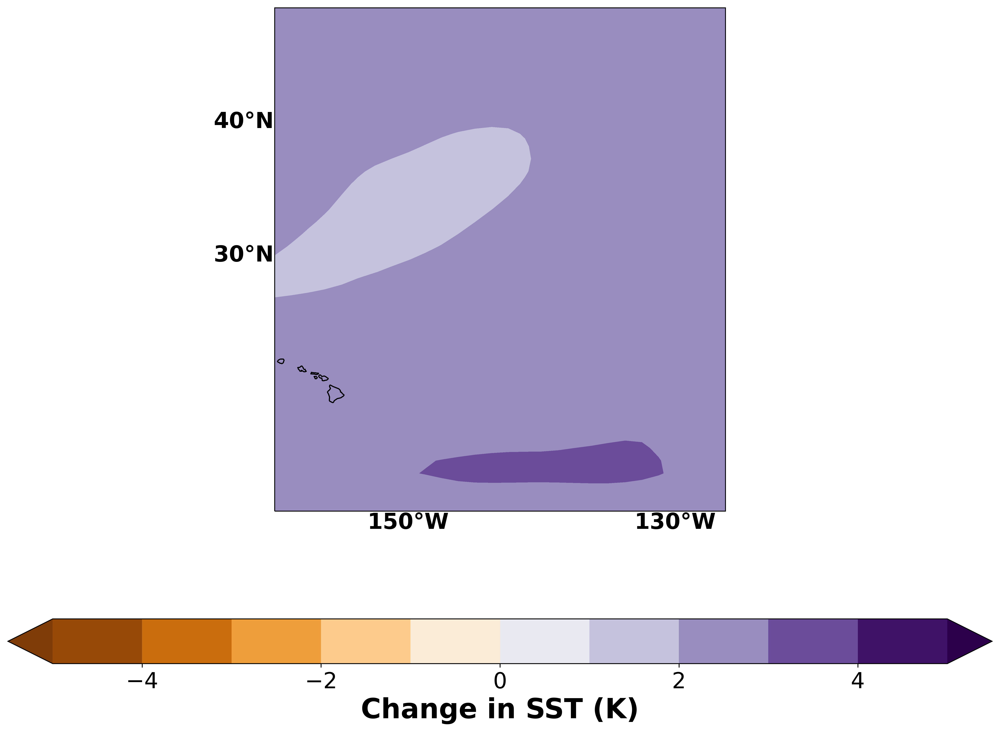

In [224]:
#conlevels = np.linspace(-5,5,11)
#figure(num=None, figsize=(16, 12), dpi=450, facecolor='w', edgecolor='k')
#ax = plt.axes(projection = ccrs.PlateCarree(central_longitude= -102.5,globe=None))
#colormap = plt.cm.get_cmap('PuOr') 

#a = ((ssp370dec-histdec)+(ssp370jan-histjan)+(ssp370feb-histfeb))/3
#plt.contourf(lon[160:188],lat[107:148],a[107:148,160:188],conlevels,
#			transform=ccrs.PlateCarree(), extend = 'both', cmap=colormap)

#ax.add_feature(cfeature.LAND)
#ax.add_feature(cfeature.COASTLINE)
#ax.add_feature(cfeature.BORDERS)
#states_provinces = cfeature.NaturalEarthFeature(
#		category='cultural',
#		name='admin_1_states_provinces_lines',
#		scale='50m',
#		facecolor='none')
#SOURCE = 'Natural Earth'
#LICENSE = 'public domain'
#ax.add_feature(states_provinces, edgecolor='gray')

#cbar = plt.colorbar(orientation='horizontal')
#cbar.ax.set_xlabel('Change in SST (K)', fontsize = 25,rotation=0,weight='bold')
#cbar.ax.tick_params(labelsize=20) 

#gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
#				  linewidth=0, color='gray', alpha=0.5)
#gl.xlabel_style = {'size': 20, 'weight': 'bold'}
#gl.ylabel_style = {'size': 20, 'weight': 'bold'}
#gl.xlabels_top = False
#gl.ylabels_right = False
#gl.xlocator = matplotlib.ticker.FixedLocator([-190,-170,-150,-130,-110])
#gl.ylocator = matplotlib.ticker.FixedLocator([30,40,50,60,70])


#plt.plot()
#warnings.filterwarnings("ignore", category=DeprecationWarning)


In [225]:
#print("Change from HIST to SSP 3-7.0 in CESM2 = "+str(np.mean(a[107:148,160:188]))+" degrees")

Change from HIST to SSP 3-7.0 in CESM2 = 2.510832363876061 degrees
